In [1]:
import numpy as np

import matplotlib.pyplot as plt
from scipy.integrate import odeint
import mpmath as mpmath

# %matplotlib notebook 
%matplotlib inline 

In [ ]:
#try using formulas in shev08 and stick to lambda<1 which means higher omega
#so that we can avoid resonances within the separatrix 

In [2]:
# routines for classical system integration 

# set up equations of motion
# y = [phi,p]  dimension 2
# H(phi,p,tau) = a(1 - cos (p-b)) - epsilon*cos phi - mu*cos(phi - tau) - mup*cos(phi + tau)
# dy/dt = [\dot phi, \dot p]
#       = [a\sin p, -epsilon*sin(phi) - mu*sin(phi - tau) - mup*sin(phi + tau) ]
#There should be three islands, one at p=0 and the others at sin p=1/a
#the widths of these are set by \sqrt{2 epsilon/a}, \sqrt{2 mu/a},  \sqrt{2 mup/a}

# dy/dtau = func(y,tau), needed for integrator!
# note that y[0] = phi and y[1] = p
def cfunc(y,tau,a,b,epsilon,mu,mup):
        return [a*np.sin(y[1]-b),\
                -epsilon*np.sin(y[0]) - mu*np.sin(y[0] - tau) - mup*np.sin(y[0] + tau)]

def H_classical(p,phi,tau,a,b,epsilon,mu,mup):
    #phi = y[0]; p = y[1]
    return a*(1.0 - np.cos(p-b)) - epsilon*np.cos(phi)\
        - mu*np.cos(phi-tau) - mup*np.cos(phi+tau)

# integrate at a period, the forced pendulum 
# arguments:
#   y0: is initial conditions, 
#   npoints: is number of points we want
#   a,epsilon, mu, mup: are parameters of the Hamiltonian model
#   taushift:  points of output are at times  taushift + 2 pi n, integer n up to npoints 
#
#   integrate every 2 pi period, npoints returned including initial condition 
# returns: phi,p arrays of integrated points 
# this particular routin does all times at once by sending a set of times to the integrator
# if we want to take p modulo 2pi we would have to integrate slowly to find when trajectories
# cross pi or -pi
twopi = 2.0*np.pi
def givepoints_arr(y0,npoints,a,b,epsilon,mu,mup,taushift):
    # set up time array, every 2pi/nu so for period of perturbation
    step  = 2.0*np.pi
    stop = step*npoints
    time  = np.arange(0.0,stop,step)  # time array for outputs  goes from 0 to stop-step 
    #                              with increment step, does not reach stop. 
    time += taushift  # shift time vector 
    # do the integration
    y = odeint(cfunc, y0, time, args=(a,b,epsilon,mu,mup))
    #y2 = odeint(func, y0, time, Dfun=jacobian, args=(epsilon,mu,nu))  # if you want to use a jacobian
    phi_arr = np.squeeze(y[:,0])  # is an array of phi at different times
    p_arr = np.squeeze(y[:,1])    # is an array of momenta at different times
    
    phi_arr  = phi_arr%twopi  # so that phi in [0:2pi]
    p_arr = p_arr%twopi  # so that p is in [0,2pi]
    
    ii = phi_arr >np.pi
    phi_arr[ii]-= twopi # now phi is in [-pi,pi]
    ii = p_arr >np.pi
    p_arr[ii]-= twopi   # now p is in [-pi,pi]
    
    return phi_arr,p_arr 
       
# integrate points and plot them on axis ax   
def givepoints(y0,npoints,a,b,epsilon,mu,mup,taushift,marker,ax):
    phi_arr,p_arr=givepoints_arr(y0,npoints,a,b,epsilon,mu,mup,taushift)
    ax.plot(phi_arr,p_arr,marker,markersize=0.5) # plot it
    
colorlist = ['black','blue','green','magenta','red','orange','gold','blueviolet','springgreen','dodgerblue']

# randomly choose an initial condition, integrate and plot in axis ax 
# arguments:
#    npoints: numbers of points to plot 
#    pmin, pmax constrain the vertical width of randomly chosen initial conditions 
#    a,epsilon,mu,mup,b: parameters for the dynamical model 
#    ax  the axis on which to plot points 
def rand_give_points(npoints,a,b,epsilon,mu,mup,taushift,pmin,pmax,ax):
    phi = np.random.uniform(low=-np.pi,high=np.pi)
    p = np.random.uniform(low=pmin,high=pmax)
    y0 = [phi,p]
    phi_arr,p_arr=givepoints_arr(y0,npoints,a,b,epsilon,mu,mup,taushift)
    i = np.random.randint(low=0,high =len(colorlist))
    ax.scatter(phi_arr,p_arr,s=1,edgecolor='none',facecolor=colorlist[i],lw=1)

# make a surface of section figure with orbits 
# inputs: a classical model class, and a label
def mkfig_cl(cla,alabel):
    norb = cla.norb
    npoints = cla.npoints
    a = cla.a 
    b = cla.b 
    eps = cla.eps
    mu = cla.mu
    mup = cla.mup 
    taushift = cla.taushift
    froot = cla.froot
    
    # set up display
    fig,ax = plt.subplots(1,1,figsize=(3,3),dpi=200) 
    plt.subplots_adjust(bottom=0.18,top=0.90,left=0.18,right=0.98)
    ax.text(2.6,-3.9,r'$\phi$',fontsize=14)
    ax.set_ylabel('p',labelpad=0)
    ax.set_aspect('equal')

    fac=1.01
    xmax = np.pi;  ymax = np.pi;  ymin = -ymax
    ax.set_xlim([-xmax*fac,xmax*fac])
    ax.set_ylim([ ymin*fac,ymax*fac])

    parm_label = r'$a$={:.2f},'.format(a)
    parm_label += r'$\epsilon$={:.2f},'.format(eps)
    parm_label += r'$\mu$={:.2f},'.format(mu)
    muprime = r'$\mu$' + '\''
    parm_label += muprime
    parm_label += r'={:.2f},'.format(mup)
    #parm_label += r'$\nu$={:.0f}'.format(nu)
    ax.text(0,3.4,parm_label,ha='center',va='center')

    for i in range(norb):  # this many orbits 
        rand_give_points(npoints,a,b,eps,mu,mup,taushift,ymin,ymax,ax)
        
    if (len(alabel)>1):
        plt.text(-4.5,3.2,alabel,fontsize=14)
    if (len(froot)>2):
        ofile = froot + '_class.png'
        plt.savefig(ofile,dpi=300)
        
    plt.show()
     
# a class to store classical model info
#    norb:  numbers of orbits
#    npoints: numbers of points to plot 
#    a,epsilon,mu,mup,b: parameters for the dynamical model 
class Hcla:
    def __init__(self,norb,npoints,a,b,eps,mu,mup,taushift,froot):
        self.a = a
        self.b = b
        self.eps = eps
        self.mu = mu
        self.mup = mup
        self.taushift = taushift
        self.norb = norb
        self.npoints = npoints
        self.froot = froot
        self.omega_0 = np.sqrt(a*eps)
        
    # randomly choose an norb initial conditions, integrate and compute <h_0> and sqrt(<h_0^2 - <h_0>^2>)
    #  from the orbits  
    # compute   mu_arr: mean H0 of each orbit
    # compute   sig_arr: standard deviation of H0 for each orbit
    # store this info in the class itself
    def sigh0_orbs(self):
        mu_arr = np.zeros(self.norb)
        sig_arr = np.zeros(self.norb)
        max_arr = np.zeros(self.norb)
        min_arr = np.zeros(self.norb)
        for i in range(self.norb):
            phi = np.random.uniform(low=-np.pi,high=np.pi)
            p = np.random.uniform(low=-np.pi,high=np.pi)
            y0 = [phi,p]
            phi_arr,p_arr=givepoints_arr(y0,self.npoints,self.a,self.b,self.eps,self.mu,self.mup,self.taushift)
            Elist = H_classical(p_arr,phi_arr,1,self.a,self.b,self.eps,self.mu,self.mup)
            mu_arr[i] = np.mean(Elist)
            sig_arr[i] = np.std(Elist)
            max_arr[i] = np.max(Elist)
            min_arr[i] = np.min(Elist)
            
        iphi = np.argsort(mu_arr) # in order of increasing energy
        self.mu_arr = mu_arr[iphi]
        self.sig_arr = sig_arr[iphi]
        self.max_arr = max_arr[iphi]
        self.min_arr = min_arr[iphi]
        #return mu_arr,sig_arr
        
    # find separatrix orbits and integrate them! 
    def sep_high_orbit(self,npts):  # has energy 2a-epsilon
        tiny = 1e-3
        phi0 = 0.0
        p0 = np.pi-tiny
        y0 = [phi0,p0]
        phi_arr,p_arr=givepoints_arr(y0,npts,self.a,self.b,self.eps,self.mu,self.mup,self.taushift)
        Elist = H_classical(p_arr,phi_arr,1,self.a,self.b,self.eps,self.mu,self.mup)
        sig = np.std(Elist)
        dE = np.max(Elist) - np.min(Elist)
        return sig,dE
    
    def sep_low_orbit(self,npts):  # has energy epsilon
        tiny = 1e-3
        phi0 = np.pi
        p0 = tiny
        y0 = [phi0,p0]
        phi_arr,p_arr=givepoints_arr(y0,npts,self.a,self.b,self.eps,self.mu,self.mup,self.taushift)
        Elist = H_classical(p_arr,phi_arr,1,self.a,self.b,self.eps,self.mu,self.mup)
        sig = np.std(Elist)
        dE = np.max(Elist) - np.min(Elist)
        return sig,dE
    
    def print_info(self):
        # compute resonance half widths 
        wid0 = 2*np.arcsin(np.sqrt(np.abs(self.eps/self.a)))
        widmu = 2*np.arcsin(np.sqrt(np.abs(self.mu/self.a)))
        widmup = 2*np.arcsin(np.sqrt(np.abs(self.mup/self.a)))
        print('res widths {:.2f}, {:.2f}, {:.2f}'.format(wid0,widmu,widmup))
    
        if (self.a<1):
            print('res locs p=0,+-none, a <1')
        else:
            p_mu = np.arcsin(1/self.a)  # a resonance location 
            print('res locs p=0,+-{:.2f}'.format(p_mu))
            overlap1 = p_mu - (wid0+widmu)
            overlap2 = p_mu - (wid0+widmup)
            print('overlaps {:.2f} {:.2f}'.format(overlap1,overlap2)) # guess of overlaps
        
        omega0 = self.omega_0 # frequency of primary resonance 
        print('omega0 = {:.2f}'.format(omega0))
        
        # not sure what this is right now
        deltH = 4*np.pi*self.mu/omega0  * np.exp(-0.5*np.pi/omega0)  # this is the half width about 
        print('deltH = {:.3f}'.format(deltH))
        #range of energy is 2*(eps+a), range of p is 2pi so we guess at 
        Deltp = 2*deltH/(2*self.eps + 2*self.a) *2*np.pi # change in p is
        print('Deltp = {:.3f}'.format(Deltp))

1.00
[0.   0.01 0.02 0.03 0.04 0.05 0.06 0.07 0.08 0.09]


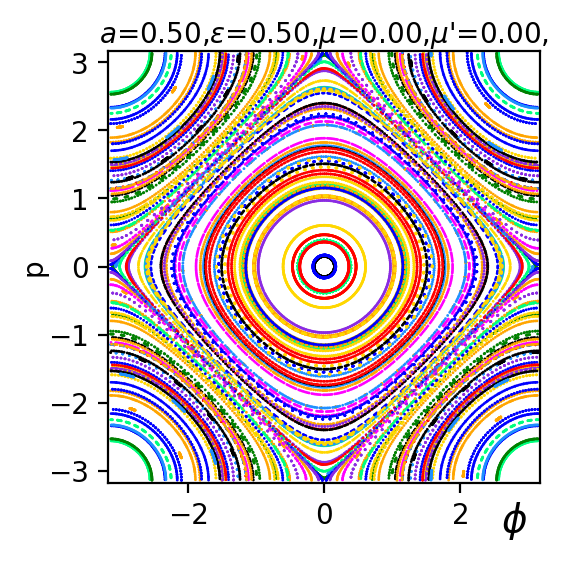

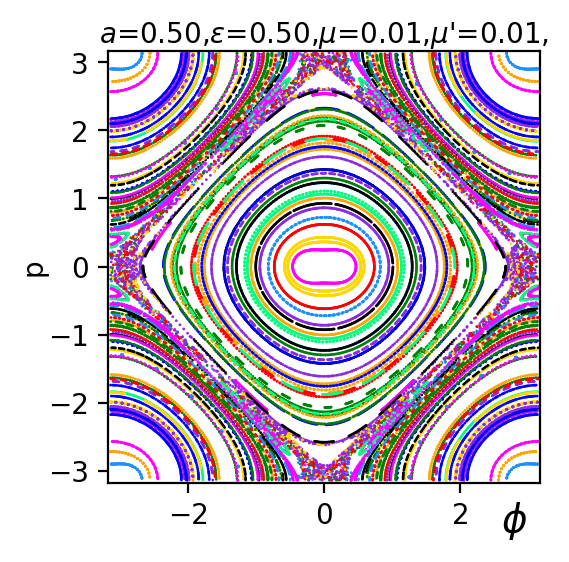

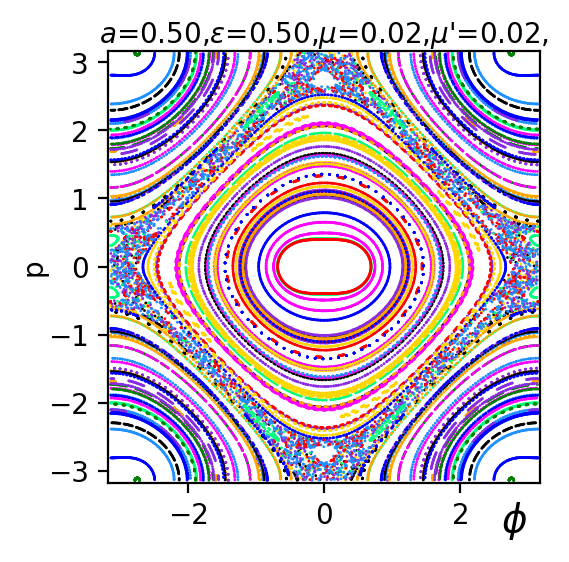

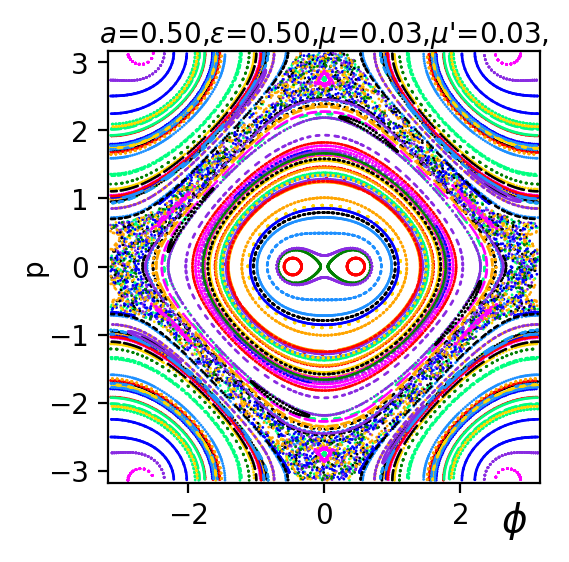

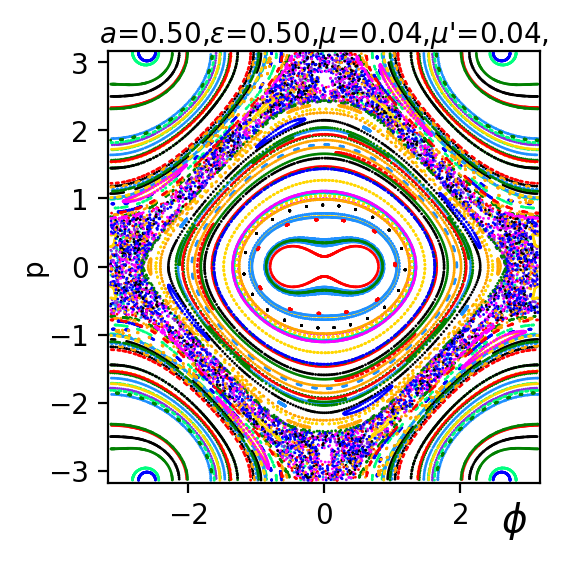

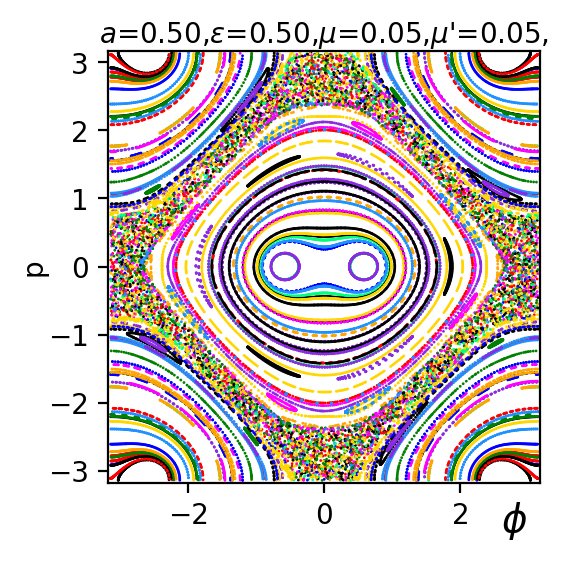

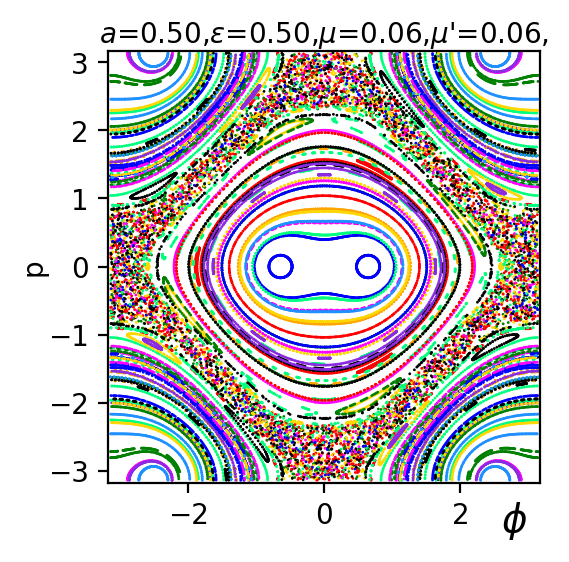

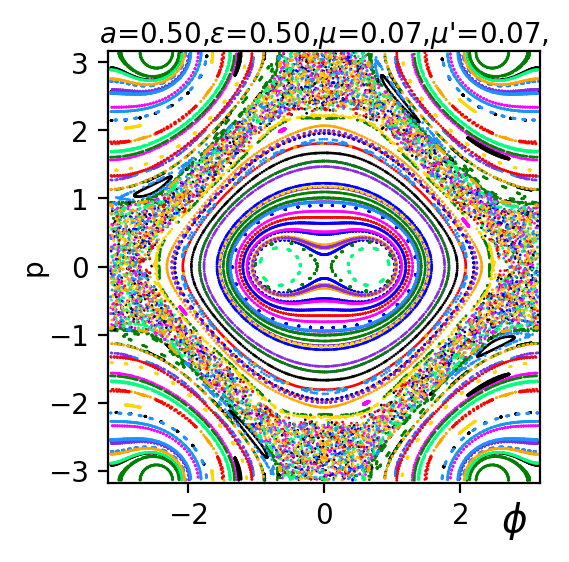

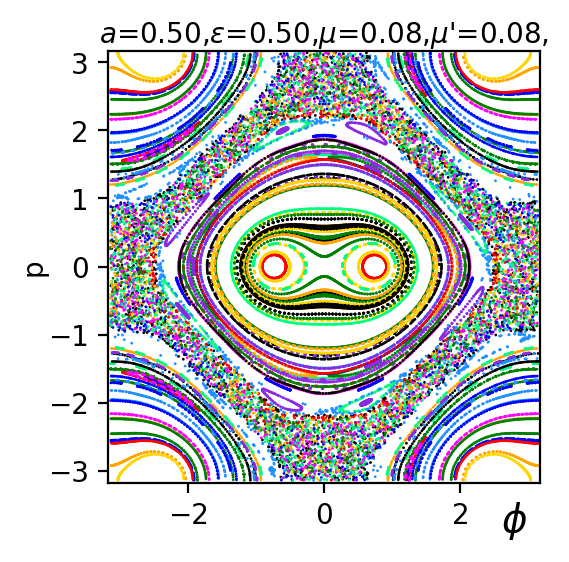

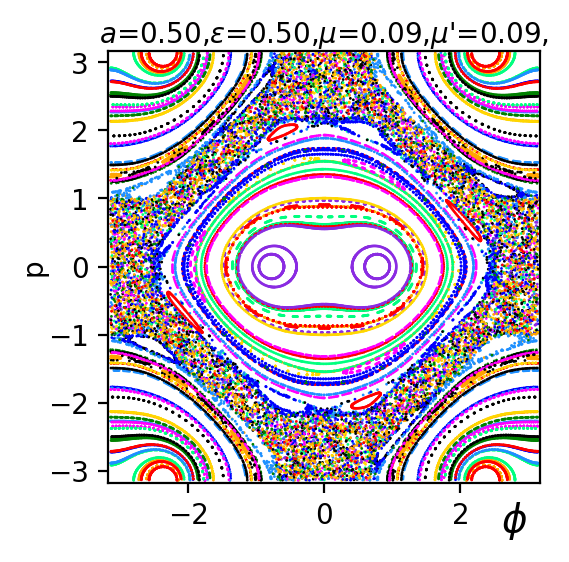

In [3]:
# choose parameters
a=0.5;  b=0; taushift = 0; eps=a; 
print('{:.2f}'.format(np.sqrt(eps/a)))
npoints=400 # points in each orbit!
norb = 100  # number of orbits
npts = 400  #points in separatrix orbit
froot = ''

mu_arr = np.arange(0,0.10,0.01)
print(mu_arr)
sig_high = mu_arr*0.0; sig_low = mu_arr*0.0; 
dE_high = mu_arr*0.0; dE_low = mu_arr*0.0;

for i in range(len(mu_arr)):
    mu=mu_arr[i]; mup=mu
    cla_0 = Hcla(norb,npoints,a,b,eps,mu,mup,taushift,froot)
    sig_high[i],dE_high[i] = cla_0.sep_high_orbit(npts)
    #sig_low[i],dE_low[i] = cla_0.sep_low_orbit(npts)
    mkfig_cl(cla_0,'')

1.00
-0.6931471805599453
[0.   0.01 0.02 0.03 0.04 0.05 0.06 0.07 0.08 0.09]


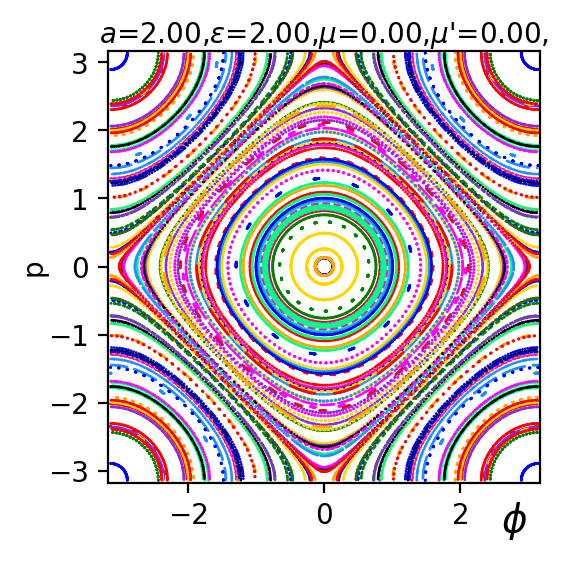

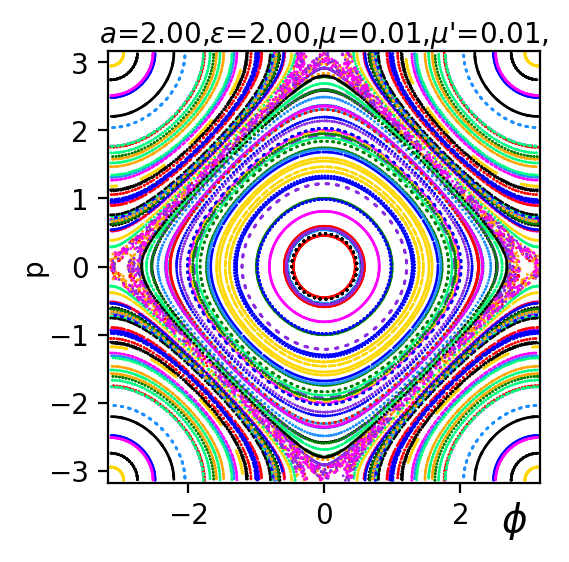

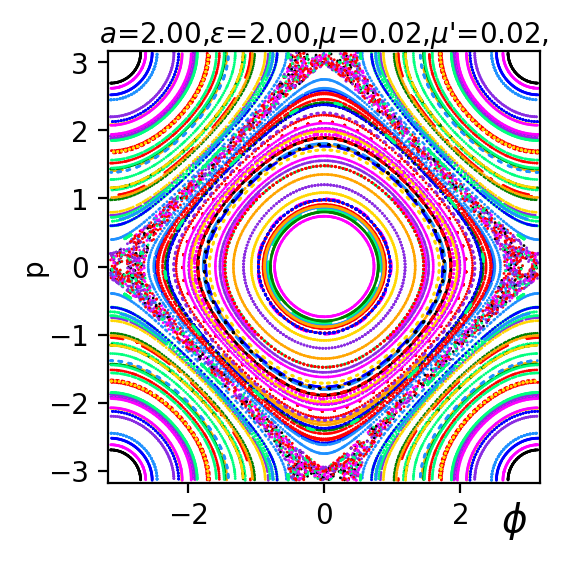

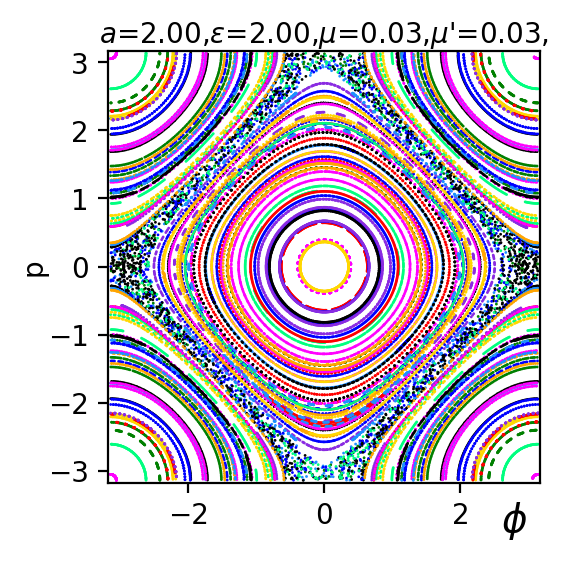

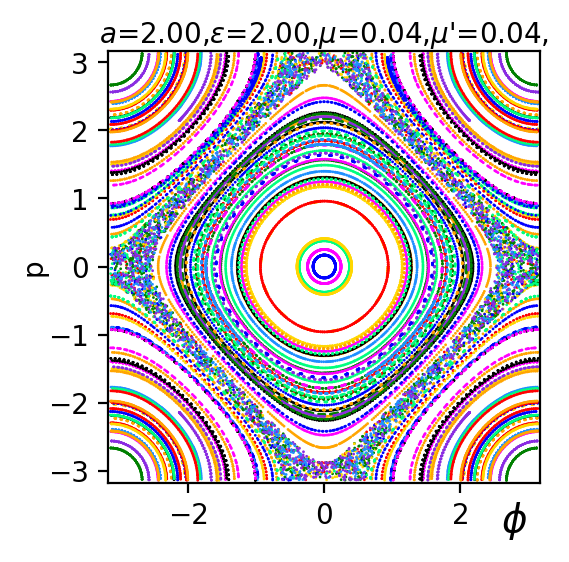

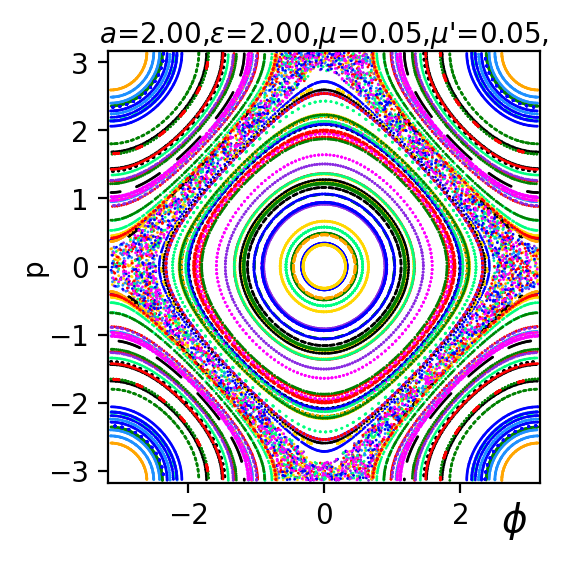

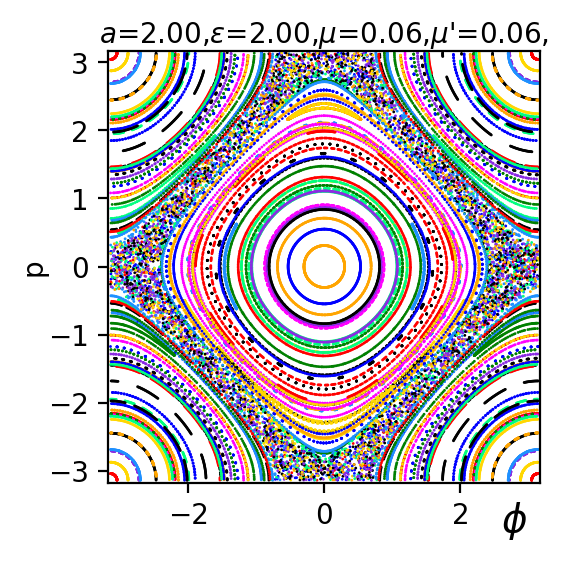

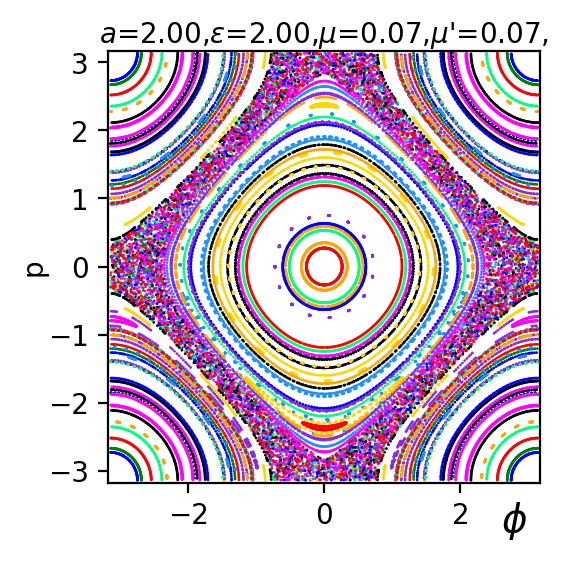

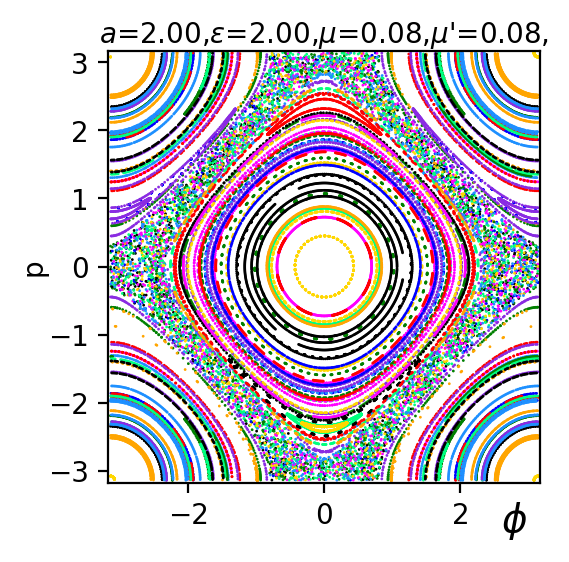

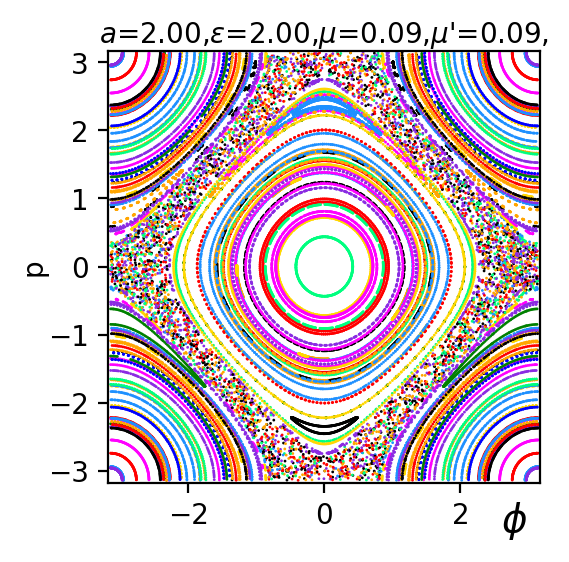

In [177]:
# choose parameters
a=2.0;  b=0; taushift = 0; eps=a; 
print('{:.2f}'.format(np.sqrt(eps/a)))
npoints=400 # points in each orbit!
norb = 100  # number of orbits
npts = 400  #points in separatrix orbit
froot = ''
lam = 1.0/np.sqrt(a*eps)
print(np.log(lam))

mu_arr1 = np.arange(0,0.10,0.01)
print(mu_arr)
sig_high1 = mu_arr*0.0; #sig_low1 = mu_arr*0.0; 
dE_high1 = mu_arr*0.0; #dE_low1 = mu_arr*0.0;

for i in range(len(mu_arr1)):
    mu=mu_arr1[i]; mup=mu
    cla_1 = Hcla(norb,npoints,a,b,eps,mu,mup,taushift,froot)
    sig_high1[i],dE_high1[i] = cla_1.sep_high_orbit(npts)
    #sig_low[i],dE_low[i] = cla_0.sep_low_orbit(npts)
    mkfig_cl(cla_1,'')

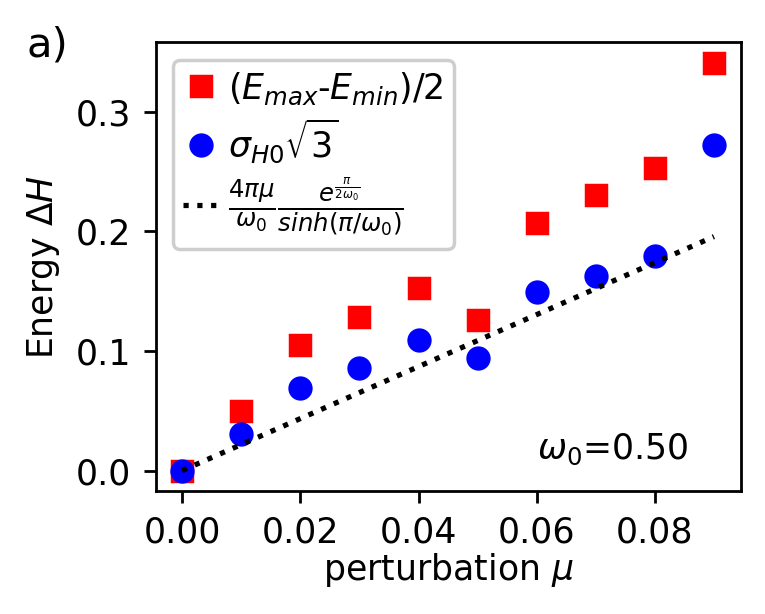

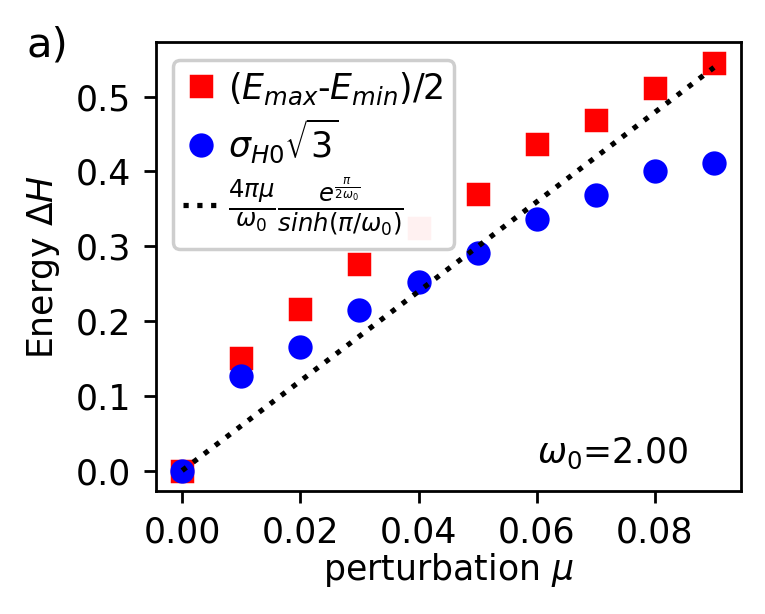

In [233]:
def plt_series(cla,mu_arr,sig_high,dE_high,alab,figname):
    omega0 = np.sqrt(cla.a*cla.eps)
    #deltH_a = 4*np.pi*mu_arr/omega0  * np.exp(-0.5*np.pi/omega0)
    #deltH_b = 4*np.pi*mu_arr/omega0**2 * np.exp(0.5*np.pi/omega0)/np.sinh(np.pi/omega0)
    deltH = 4*np.pi*(mu_arr)/(omega0) *np.exp(0.5*np.pi/omega0)/np.sinh(np.pi/omega0)

    fig, ax = plt.subplots(1,1,figsize=(3,2.3),dpi=250)
    plt.subplots_adjust(bottom=0.2,left=0.2,right=0.98,top=0.98)

    ax.plot(mu_arr,dE_high/2,'rs',label=r'$(E_{max}$-$E_{min})/2$')
    # factor of sqrt 3 from gaussian width of a square 
    ax.plot(mu_arr,sig_high*np.sqrt(3),'bo',label=r'$\sigma_{H0}\sqrt{3}$')
    ax.plot(mu_arr,deltH,'k:',label=r'$\frac{4 \pi\mu}{\omega_0} \frac{e^{\frac{\pi}{2\omega_0}}}{sinh (\pi/\omega_0)}$')
    #ax.plot(mu_arr,deltH_b,'g:')
    ax.set_xlabel(r'perturbation $\mu$',labelpad=0.5)
    ax.set_ylabel(r'Energy $\Delta H$')

    #parm_label = r'$a$={:.2f},'.format(cla.a)
    #parm_label += r'$\epsilon$={:.2f}'.format(cla.eps)
    #parm_label +='\n'
    #    parm_label += r'$\mu$={:.2f},'.format(mu)
    #    muprime = r'$\mu$' + '\''
    parm_label2 = r'$\omega_0$={:.2f}'.format(omega0)
    ax.text(0.06,0.01,parm_label2)
    ax.legend(fontsize=10,borderpad=0.3,labelspacing=0.3,handlelength=1,handletextpad=0.3,loc='upper left',\
             framealpha=0.95)
    ax.text(-0.22,0.97,alab,transform=ax.transAxes,fontsize=12)  # label a) or something like that on left corner
    
    if (len(figname)>2):
        plt.savefig(figname)

    plt.show()

plt_series(cla_0,mu_arr ,sig_high ,dE_high,'','ser5.png')
plt_series(cla_1,mu_arr1,sig_high1,dE_high1,'','ser2.png')

0.45
[0.   0.01 0.02 0.03 0.04 0.05 0.06 0.07 0.08 0.09]


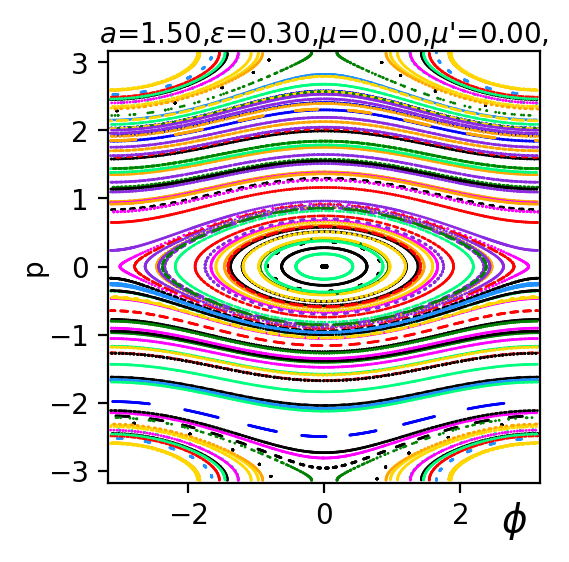

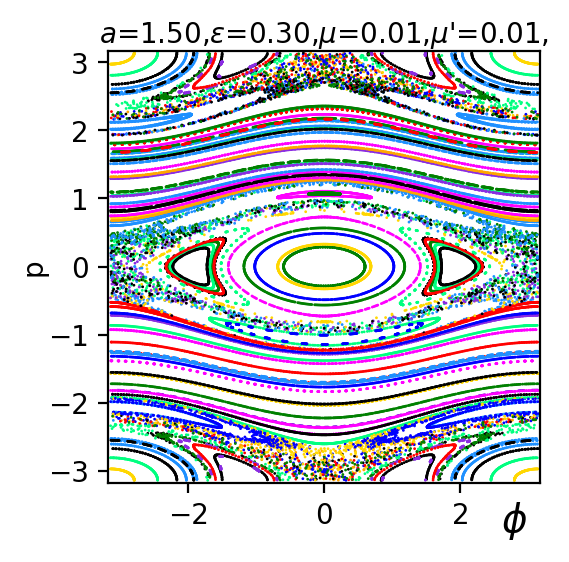

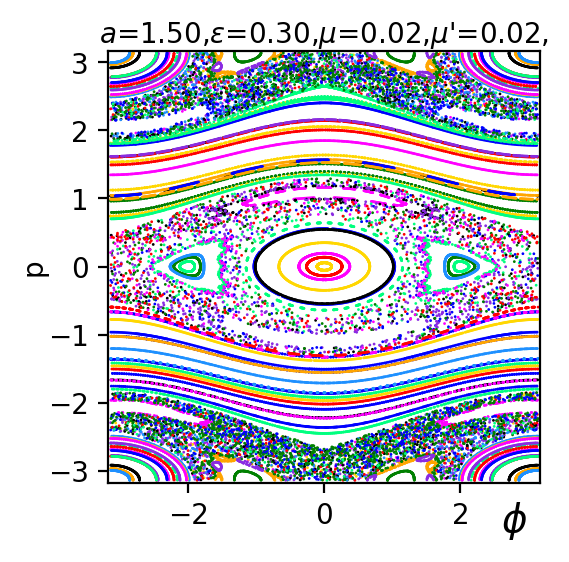

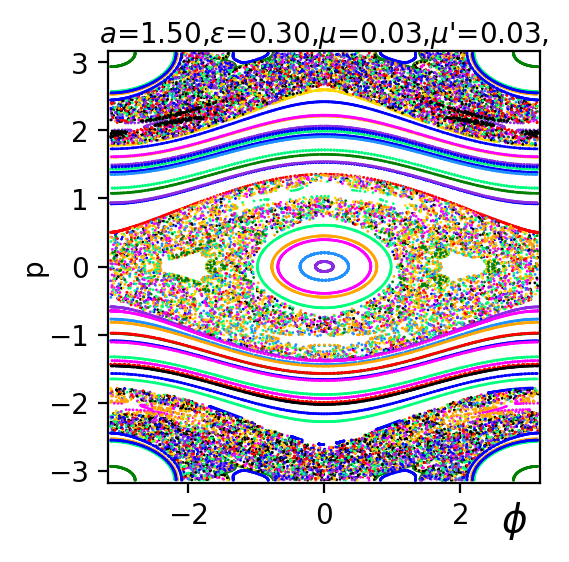

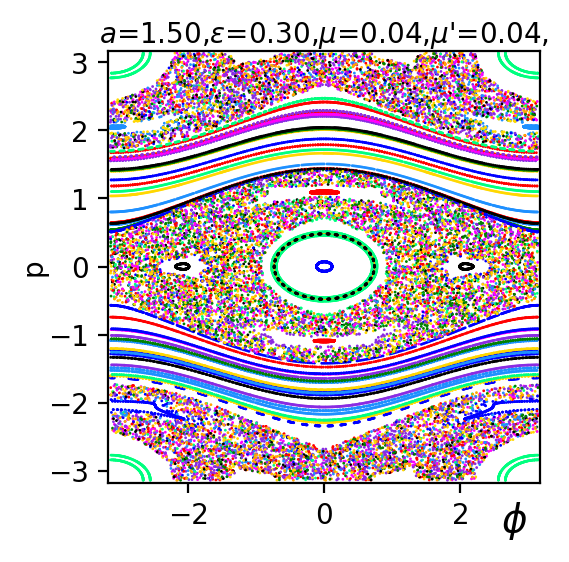

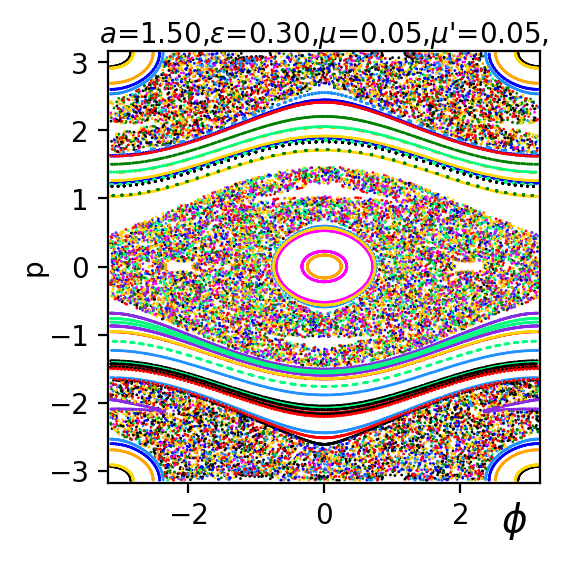

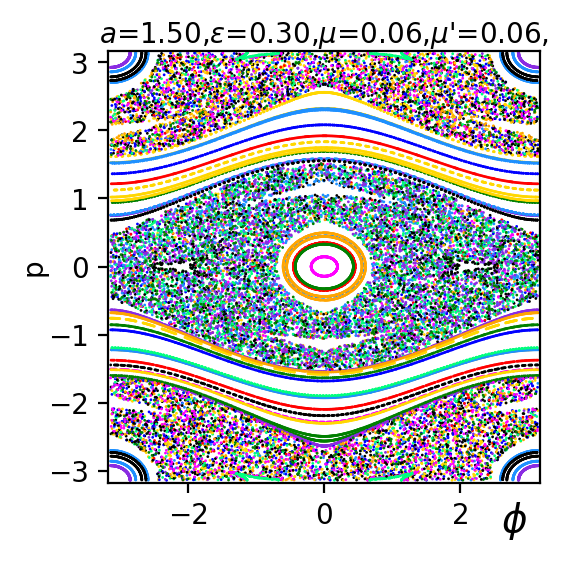

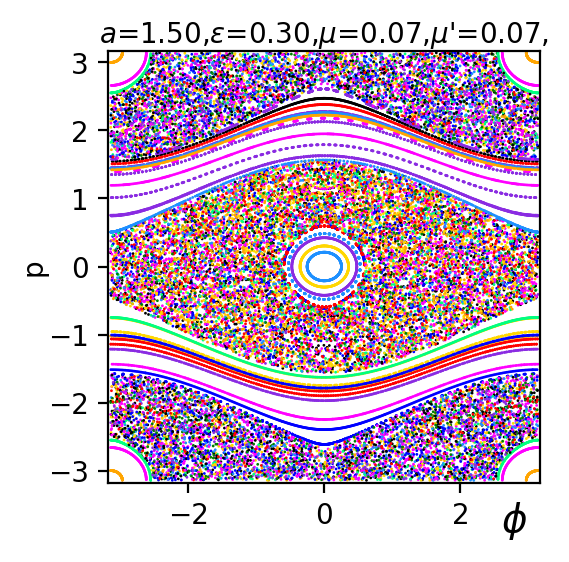

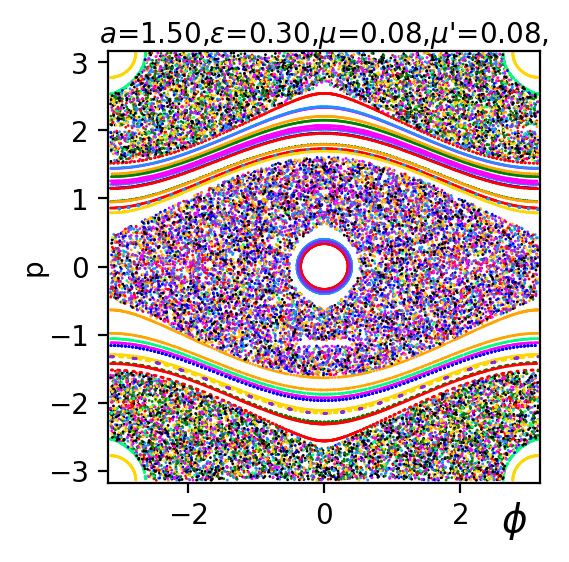

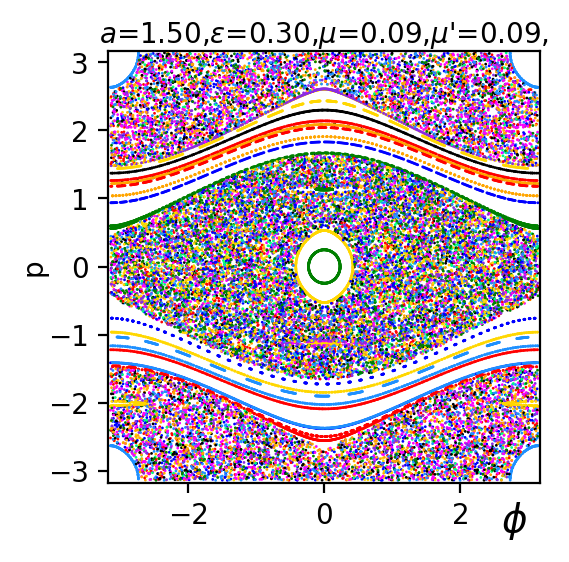

In [175]:
# choose parameters
a=1.5;  b=0; taushift = 0; eps=0.3; 
print('{:.2f}'.format(np.sqrt(eps/a)))
npoints=400 # points in each orbit!
norb = 100  # number of orbits
npts = 400  #points in separatrix orbit
froot = ''

mu_arr2 = np.arange(0,0.10,0.01)
print(mu_arr)
sig_high2 = mu_arr*0.0; #sig_low1 = mu_arr*0.0; 
dE_high2 = mu_arr*0.0; #dE_low1 = mu_arr*0.0;

for i in range(len(mu_arr1)):
    mu=mu_arr1[i]; mup=mu
    cla_2 = Hcla(norb,npoints,a,b,eps,mu,mup,taushift,froot)
    sig_high2[i],dE_high2[i] = cla_2.sep_high_orbit(npts)
    mkfig_cl(cla_2,'')

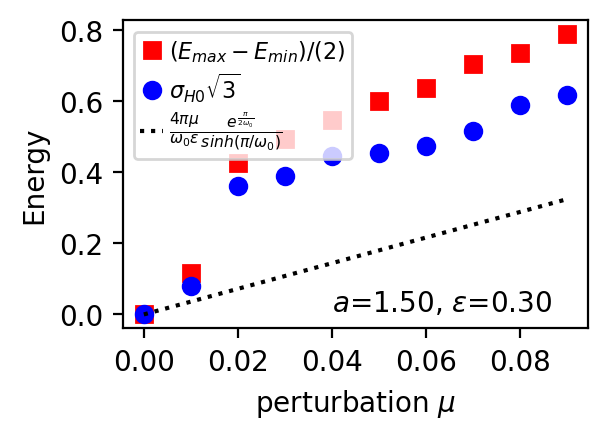

In [176]:
plt_series(cla_2,mu_arr2,sig_high2,dE_high2)

In [179]:
a_arr = np.arange(0.7,2.5,0.3)
eps_arr = a_arr
omega0_arr = 1/np.sqrt(a_arr*eps_arr)
print(omega0_arr)


[1.42857143 1.         0.76923077 0.625      0.52631579 0.45454545]


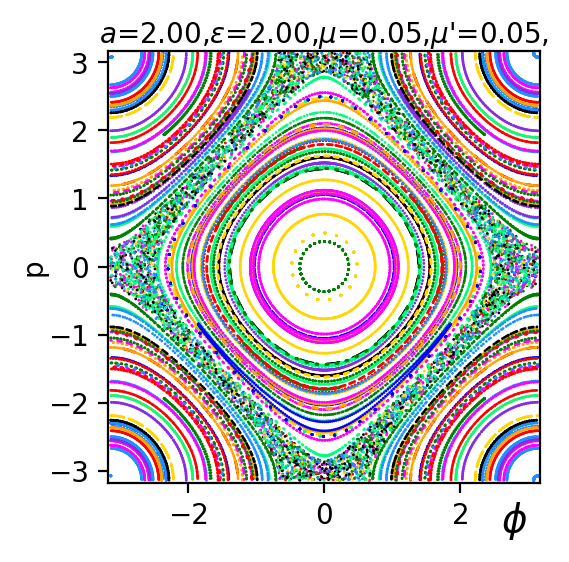

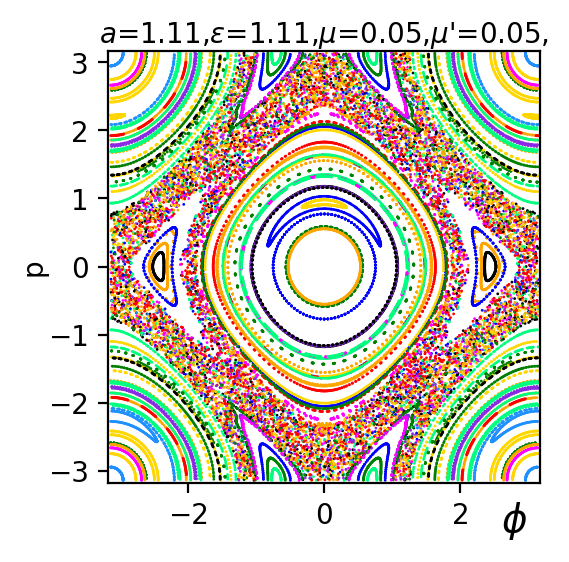

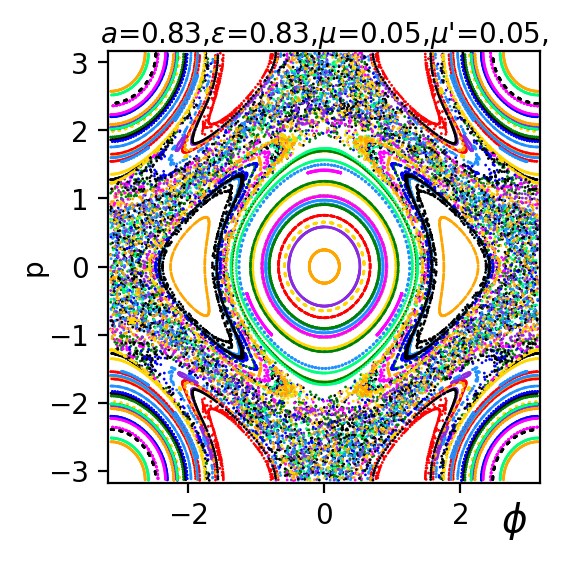

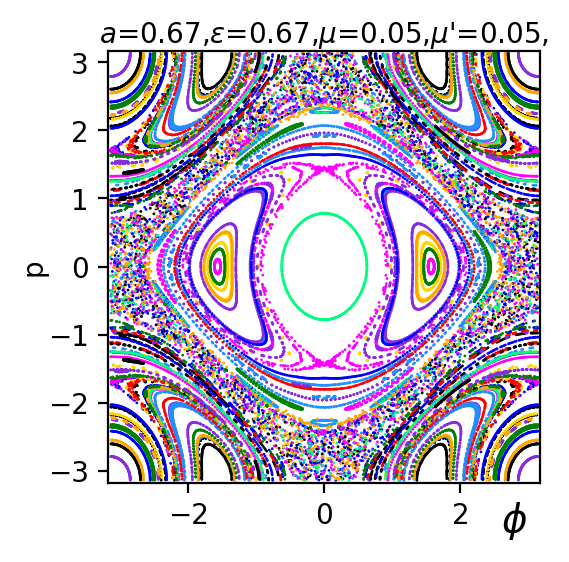

In [194]:
# choose parameters
b=0; taushift = 0; 
npoints=400 # points in each orbit!
norb = 100  # number of orbits
npts = 400  #points in separatrix orbit
froot = ''
mu = 0.05; mup = mu

llam = np.array([-1,])
om_arr = np.array([0.5,0.9,1.2,1.5])
a_arr = om_arr
eps_arr = a_arr

sig_high3 = om_arr*0.0; 
dE_high3 = om_arr*0.0; 

for i in range(len(om_arr)):
    a = 1/om_arr[i]; eps = a
    cla_3 = Hcla(norb,npoints,a,b,eps,mu,mup,taushift,froot)
    sig_high3[i],dE_high3[i] = cla_3.sep_high_orbit(npts)
    mkfig_cl(cla_3,'')


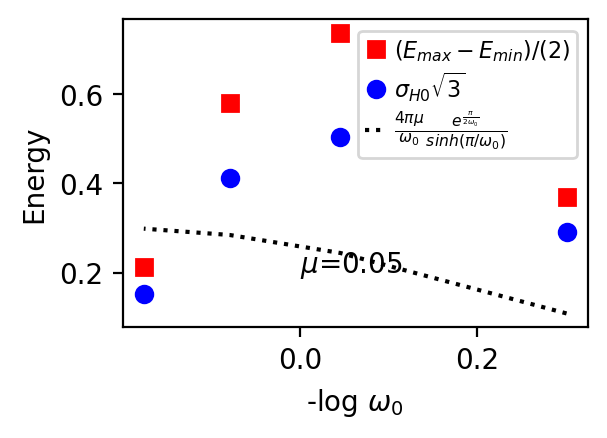

[ 0.69314718  0.10536052 -0.18232156 -0.40546511]


In [199]:
def plt_seriesb(cla,om_arr,sig_high,dE_high):
    #deltH_a = 4*np.pi*mu_arr/omega0  * np.exp(-0.5*np.pi/omega0)
    #deltH_b = 4*np.pi*mu_arr/omega0**2 * np.exp(0.5*np.pi/omega0)/np.sinh(np.pi/omega0)
    deltH = 4*np.pi*cla.mu/(om_arr) *np.exp(0.5*np.pi/om_arr)/np.sinh(np.pi/om_arr)
    
    llam = -np.log10(om_arr)

    fig, ax = plt.subplots(1,1,figsize=(3,2),dpi=200)

    ax.plot(llam,dE_high/2,'rs',label=r'$(E_{max}-E_{min})/(2)$')
    # factor of sqrt 3 from gaussian width of a square 
    ax.plot(llam,sig_high*np.sqrt(3),'bo',label=r'$\sigma_{H0}\sqrt{3}$')
    ax.plot(llam,deltH,'k:',label=r'$\frac{4 \pi\mu}{\omega_0} \frac{e^{\frac{\pi}{2\omega_0}}}{sinh (\pi/\omega_0)}$')

    ax.set_xlabel(r'-log $\omega_0$')
    ax.set_ylabel('Energy')

    parm_label = r'$\mu$={:.2f}'.format(cla.mu)
    #parm_label += r'$\epsilon$={:.2f}'.format(cla.eps)
    #    parm_label += r'$\mu$={:.2f},'.format(mu)
    #    muprime = r'$\mu$' + '\''
    ax.text(0.0,0.2,parm_label)
    ax.legend(fontsize=8,borderpad=0.3,labelspacing=0.3,handlelength=1,handletextpad=0.3)

    plt.show()

plt_seriesb(cla_3,om_arr ,sig_high3 ,dE_high3)
print(np.log(1/om_arr))

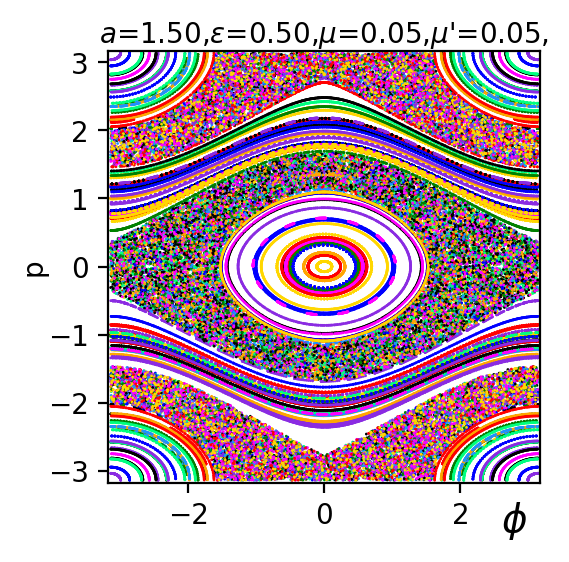

res widths 1.23, 0.37, 0.37
res locs p=0,+-0.73
overlaps -0.87 -0.87
omega0 = 0.87
deltH = 0.118
Deltp = 0.372


In [25]:
# choose parameters
a=1.5;  b=0; taushift = 0 
eps=0.5
mu=0.05; mup=mu
npoints=100 # points in each orbit!
norb = 200  # number of orbits
froot = ''
cla_Q9b_b = Hcla(norb,npoints,a,b,eps,mu,mup,taushift,froot)

mkfig_cl(cla_Q9b_b,'')
#cla_Q9b_b.print_info()
#cla_Q9b_b.sigh0_orbs()


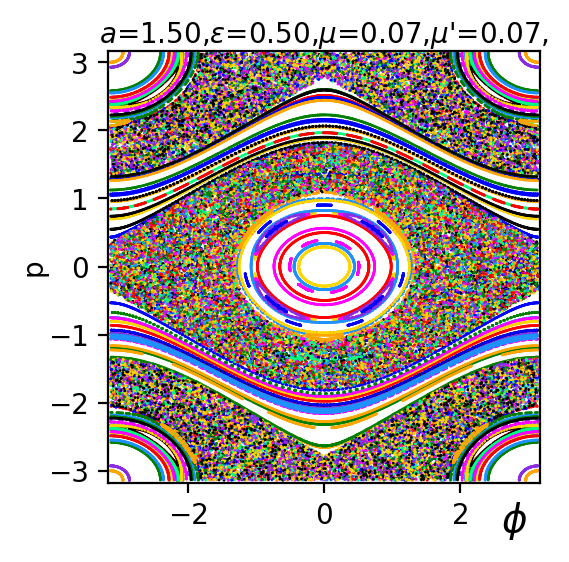

res widths 1.23, 0.45, 0.45
res locs p=0,+-0.73
overlaps -0.95 -0.95
omega0 = 0.87
deltH = 0.177
Deltp = 0.557


In [26]:
# choose parameters
a=1.5;  b=0; taushift = 0 
eps=0.5
mu=0.075; mup=mu
npoints=500 # points in each orbit!
norb = 200  # number of orbits
froot = ''
cla_Q9b_c = Hcla(norb,npoints,a,b,eps,mu,mup,taushift,froot)

mkfig_cl(cla_Q9b_c,'')
cla_Q9b_c.print_info()
cla_Q9b_c.sigh0_orbs()

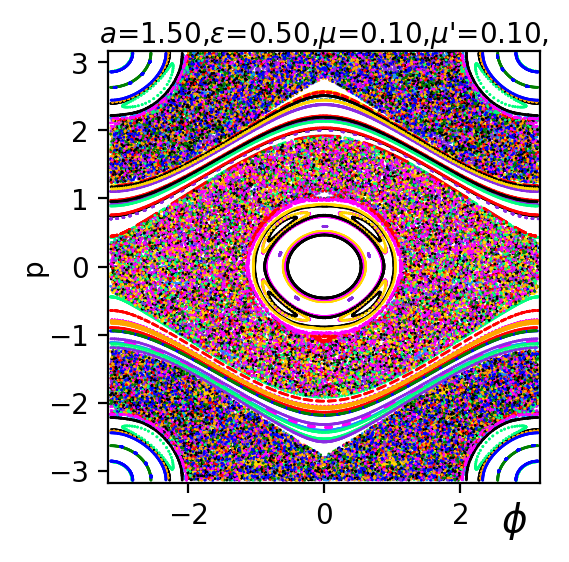

res widths 1.23, 0.52, 0.52
res locs p=0,+-0.73
overlaps -1.02 -1.02
omega0 = 0.87
deltH = 0.237
Deltp = 0.743


In [27]:
# choose parameters
a=1.5;  b=0; taushift = 0 
eps=0.5
mu=0.1; mup=mu
npoints=500 # points in each orbit!
norb = 200  # number of orbits
froot = ''
cla_Q9b_d = Hcla(norb,npoints,a,b,eps,mu,mup,taushift,froot)

mkfig_cl(cla_Q9b_d,'')
cla_Q9b_d.print_info()
cla_Q9b_d.sigh0_orbs()

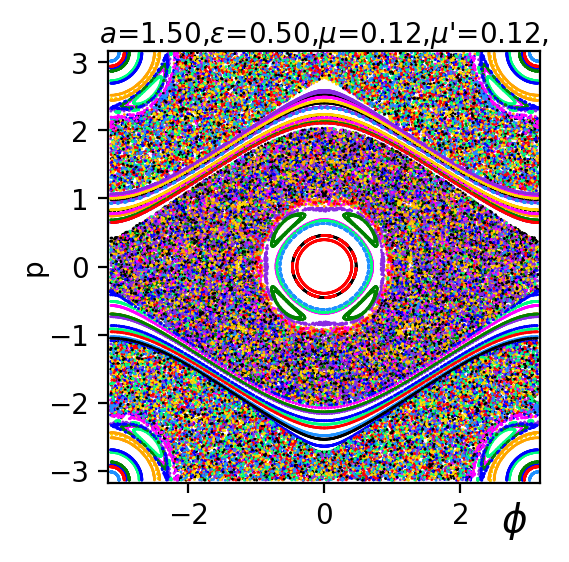

res widths 1.23, 0.59, 0.59
res locs p=0,+-0.73
overlaps -1.09 -1.09
omega0 = 0.87
deltH = 0.296
Deltp = 0.929


In [28]:
# choose parameters
a=1.5;  b=0; taushift = 0 
eps=0.5
mu=0.125; mup=mu
npoints=500 # points in each orbit!
norb = 200  # number of orbits
froot = ''
cla_Q9b_e = Hcla(norb,npoints,a,b,eps,mu,mup,taushift,froot)

mkfig_cl(cla_Q9b_e,'')
cla_Q9b_e.print_info()
cla_Q9b_e.sigh0_orbs()

In [ ]:
a=1.5;  b=0; taushift = 0 
eps=0.5; mu=0.0; mup=mu
cla_Q9b_vanil = Hcla(norb,npoints,a,b,eps,mu,mup,taushift,froot)
mu=0.025; mup=mu


In [42]:
def sep_orbs(sim):
    a = sim.a
    eps = sim.eps
    omega_0= np.sqrt(a*eps)
    mu_arr = sim.mu_arr
    sig_arr = sim.sig_arr
    E1 = eps;
    E2 = 2*a - eps
    
    isep1 = np.argmin(np.abs(mu_arr-E1))
    isep2 = np.argmin(np.abs(mu_arr-E2))
    
    sig1 = sim.sig_arr[isep1]
    sig2 = sim.sig_arr[isep2]
    #print(sig_arr[isep1],sig_arr[isep2])
    dE1 = sim.max_arr[isep1] - sim.min_arr[isep1]
    dE2 = sim.max_arr[isep2] - sim.min_arr[isep2]
    #print(dE1,dE2)
    
    return sig1,sig2,dE1,dE2
    
#sig1,sig2,dE1,dE2 = sep_orbs(cla_Q9b_vanil)


In [56]:


def fil_sim_lists(sim_list):
    nsim = len(sim_list)
    dE1_list = np.zeros(nsim)
    dE2_list = np.zeros(nsim)
    sig1_list = np.zeros(nsim)
    sig2_list = np.zeros(nsim)
    mu_list = np.zeros(nsim)
    a = sim_list[0].a
    eps = sim_list[0].eps
    omega0 = np.sqrt(a*eps)
    
    i=0
    for sim in sim_list:
        sig1,sig2,dE1,dE2 = sep_orbs(sim)
        dE1_list[i] = dE1
        dE2_list[i] = dE2
        sig1_list[i] = sig1
        sig2_list[i] = sig2
        mu_list[i] = sim.mu
        i+= 1
        
    deltH = 4*np.pi*mu_list/omega0  * np.exp(-0.5*np.pi/omega0)
    
    deltH = 4*np.pi*mu_list/omega0**2 * np.exp(0.5*np.pi/omega0)/np.sinh(np.pi/omega0)
        
    return dE1_list,dE2_list,sig1_list,sig2_list,mu_list,deltH

sim_list = [cla_Q9b_vanil,cla_Q9b_a,cla_Q9b_b,cla_Q9b_c,cla_Q9b_d,cla_Q9b_e ]   
dE1_list,dE2_list,sig1_list,sig2_list,mu_list,deltH = fil_sim_lists(sim_list)

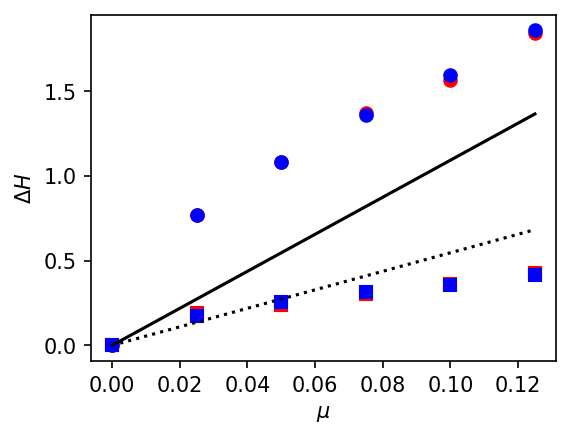

In [59]:
fig, ax = plt.subplots(1,1,figsize=(4,3),dpi=150)

ax.plot(mu_list,dE1_list,'ro')
ax.plot(mu_list,dE2_list,'bo')
ax.plot(mu_list,sig1_list,'rs')
ax.plot(mu_list,sig2_list,'bs')
ax.plot(mu_list,deltH,'k:')
ax.plot(mu_list,2*deltH,'k-')
   
ax.set_xlabel(r'$\mu$')
ax.set_ylabel(r'$\Delta H$')
plt.show()

In [20]:
# routines for displacement operator, coherent states and Husimi distribution 

# return Shift operator Xhat as a 2d NxN complex matrix (unitary)   
def Xhat_op(N): # in regular basis 
    X = np.zeros((N,N),dtype=complex)
    for k in range(N):
        X[(k+1)%N,k] = 1.0 + 0j
    return X

# return clock operator Zhat as a 2d NxN complex matrix (unitary)  
def Zhat_op(N):  # in regular basis
    Z = np.zeros((N,N),dtype=complex)
    for k in range(N):
        omegaj = np.exp(2*np.pi*k*1j/N)
        Z[k,k] = omegaj 
    return Z

def Zhat_dagger_op(N):
    return np.conjugate(Zhat_op(N))

def Xhat_dagger_op(N):
    return np.transpose(Xhat_op(N))

def cos_phi_op(N):
    return (Zhat_op(N) + Zhat_dagger_op(N))*0.5

def sin_phi_op(N):
    return (Zhat_op(N) - Zhat_dagger_op(N))/(2.0j)

def cos_p_op(N):
    return (Xhat_op(N) + Xhat_dagger_op(N))*0.5

def sin_p_op(N):
    return (Xhat_op(N) - Xhat_dagger_op(N))/(2.0j)


# create Dhat_kl, the displacement operator as a function of k,l  
# returns an NxN complex matrix, is unitary 
# computes \hat D_{kl} = \omega^{-kl/2} \hat X^l \hat Z^k
def Displacement_op(N,k,l):
    #D = np.zeros((N,N),dtype=complex)
    omega = np.exp(2*np.pi*1j/N)
    #omfac = np.power(-omega*k*l/2.0)
    X = Xhat_op(N)
    Z = Zhat_op(N)
    Xl = np.linalg.matrix_power(X, l)
    Zk = np.linalg.matrix_power(Z, k)
    Dhat= np.power(omega,-k*l/2.0) * np.matmul(Zk,Xl)
    return Dhat

# computes eigenfunction |\tilde eta> of the QFT 
# returns an N dimensional complex normalized statevector 
# This is a unimodal periodic thing which is peaked at index 0
def eta_tilde(N):
    eta = np.zeros(N,dtype=complex)
    efac = np.exp(-np.pi/N)
    for m in range(N):  # compute using theta function 
        eta[m] = np.real(mpmath.jtheta(3,np.pi*m/N,efac)/np.sqrt(N))
    eta_mag = np.sqrt(np.sum(eta*np.conj(eta)))
    eta = eta/eta_mag   # normalize
    return eta

#  Creat a coherent state from Displacement operator hat D and eigenfunction |tilde eta>
# returns an N dimensional complex normalized state vector 
def coherent_state(N,k,l):
    Dhat = Displacement_op(N,k,l)
    eta=eta_tilde(N)
    ch = np.matmul(Dhat,eta)
    return ch

# make a set of coherent states from QFT eigenfunction |tilde eta> and displacement op Dhat
# returns an N x N x N 3D complex array 
#   the matrix [k,l,:] is the coherent state |k,l>
def coh_Dkl(N):
    c_matrix = np.zeros((N,N,N),dtype=complex)
    eta=eta_tilde(N)  #only do this once
    omega = np.exp(2*np.pi*1j/N)  #only do this once
    #omfac = np.power(-omega*k*l/2.0)
    X = Xhat_op(N) # only do this once
    Z = Zhat_op(N) # only do this once
    for k in range(N):
        Zk = np.linalg.matrix_power(Z, k)
        for l in range(N):
            Xl = np.linalg.matrix_power(X, l)
            Dhat = np.power(omega,-k*l/2.0) * np.matmul(Zk,Xl)
            #Dhat = Displacement_op(N,k,l)
            c_matrix[k,l,:] = np.matmul(Dhat,eta)  
            # if displacement is in p direction then p increases with l
            # and k increases in x direction 
            # note that imshow displays arrays with [j,k] with j in y direction
    return c_matrix

# make a set of coherent states from QFT eigenfunction |tilde eta> and displacement op
# returns an N x N x N 3D complex array 
#   the matrix [k,l,:] is the coherent state |k,l>
#  a more efficient version 
def coh_Dkl_b(N):
    c_matrix = np.zeros((N,N,N),dtype=complex)
    eta=eta_tilde(N)  #only do this once
    omega = np.exp(2*np.pi*1j/N)  #only do this once
    #omfac = np.power(-omega*k*l/2.0)
    X = Xhat_op(N) # only do this once
    Z = Zhat_op(N) # only do this once
    Zk = np.linalg.matrix_power(Z, 0)
    for k in range(N):
        Xl = np.linalg.matrix_power(X, 0)
        for l in range(N):
            #Xl = np.linalg.matrix_power(X, l)
            Dhat = np.power(omega,-k*l/2.0) * np.matmul(Zk,Xl)
            #Dhat = Displacement_op(N,k,l)
            c_matrix[k,l,:] = np.matmul(Dhat,eta)  
            # if displacement is in p direction then p increases with l
            # and k increases in x direction 
            # note that imshow displays arrays with [j,k] with j in y direction
            Xl = np.matmul(X,Xl)
        Zk = np.matmul(Z,Zk)
    return c_matrix
   
# compute Hussimi distribution of an N dimensional state vector psi 
# in advance you have computed a set of coherent states with above
#    routine coh_Dkl(N) or coh_Dkl_b(N)
# the set of coherent states is given via the argument c_matrix 
#    c_matrix should be an NxNxN matrix 
# the routine returns an NxN real matrix which is the Hussimi function  
#   note that index order is p,x  so that y would be first index, as expected for plotting with imshow
def Husimi(psi,c_matrix):
    N = len(psi)
    H_matrix = np.zeros((N,N))
    cshape = c_matrix.shape
    if (cshape[0] != N):
        print('c_matrix is wrong dimension')
    for k in range(N):
        for l in range(N):
            co_kl = np.squeeze(c_matrix[k,l,:])  #coherent state |k,l> -p,x
            mag = np.vdot(psi,co_kl) # dot product
            mag = np.absolute(mag) # is real 
            H_matrix[k,l] = mag**2  

    return H_matrix

In [168]:
# compute the propagator U across tau =0 to  2 pi
# trying a somewhat more efficient way to do this!
#  arguments:
#     N      : size of discrete quantum space 
#     ntau   : how many Trotterized steps to take 
#     a,b,eps,mu,mup,taushift      : parameters of classical model, all unitless 
#  returns:  
#    Ufinal  : The propagator hat U_T  (NxN complex matrix)
#    w       : vector of eigenvalues of U in order of increasing phase
#    vr      : vector of associated eigenfunctions of U 
#        vr[:,j] is the eigenvector with eigenvalue w[j]
# note we have shifted indexing so that phi=0, p=0 is in the center of the 2d arrays
def U_prop2(N,ntau,a,b,eps,mu,mup,taushift):
    DLambda_A =np.zeros((N,N),dtype=complex)  # storing diagonal matrix for momentum part
    DLambda_Ah =np.zeros((N,N),dtype=complex)  # storing diagonal matrix for momentum part
    DLambda_Ahm =np.zeros((N,N),dtype=complex)  # storing diagonal matrix for momentum part
    DLambda_B =np.zeros((N,N),dtype=complex)  # storing diagonal matrix for phi part
    U_final  =np.zeros((N,N),dtype=complex)  # final propagator
    #Efac = N**2/(4.0*np.pi*ntau)    # includes dtau , is wrong
    Efac = N/ntau    # Bohr Sommerfeld type quantization gives this
    # this is L_0/hbar x 2pi/ntau = N/2pi x 2pi/ntau = N/ntau, is correct , includes dtau
    
    dtau = 2*np.pi/ntau  # step size 
    Q_FT,Q_FT_dagger = QFT(N)  # need only be computed once
    for k in range(N):  #compute ahead of time, fill diagonals
        pk = 2*np.pi*k/N - np.pi  # shifted so 0,0 in center of arrays
        DLambda_Ah[k,k] = np.exp(-0.5j*Efac*a*(1.0 - np.cos(pk-b))) #diagonal in Fourier basis
        DLambda_A[k,k]  = np.exp(  -1j*Efac*a*(1.0 - np.cos(pk-b))) 
        DLambda_Ahm[k,k]= np.exp( 0.5j*Efac*a*(1.0 - np.cos(pk-b))) 
        # these are half step and full step for the momentum part
        
    LAh     = np.matmul(Q_FT,np.matmul(DLambda_Ah ,Q_FT_dagger))  # transfer basis 
    LA      = np.matmul(Q_FT,np.matmul(DLambda_A  ,Q_FT_dagger))   
    LAh_inv = np.matmul(Q_FT,np.matmul(DLambda_Ahm,Q_FT_dagger))
    
    U_final = LAh;  #inverse half step at the beginning 
        
    for i in range(ntau): # each dtau
        tau = i*dtau + taushift # time of propagator shifted by taushift
        for j in range(N):
            phi = 2*np.pi*j/N - np.pi  # shifted so 0,0 in center of arrays 
            DLambda_B[j,j] = np.exp(1j*Efac*(\
                eps*np.cos(phi)+mu*np.cos(phi-tau)+mup*np.cos(phi+tau) )) # create diagonal matrix 
            # note sign of 1j 
        U_final = np.matmul(LA,np.matmul(DLambda_B,U_final))
        
    U_final = np.matmul(LAh_inv,U_final)
    
    (w,vr)=np.linalg.eig(U_final)  # get eigenvalues and eigenvectors
    w_s,vr_s = esort_phase(w,vr)   # sort in order of increasing eigenvalue phase
    return w_s,vr_s,U_final 
            
            

In [7]:


# fill matrices with Discrete Fourier transform, returns 2 nxn matrices
# both Q_FT and Q_FT^dagger which is the inverse 
def QFT(n):
    omega = np.exp(2*np.pi*1j/n)
    Q        = np.zeros((n,n),dtype=complex)  # QFT
    Q_dagger = np.zeros((n,n),dtype=complex) 
    for j in range(n):
        for k in range(n):
            Q[j,k] = np.power(omega,j*k)  # not 100% sure about sign here! 
            Q_dagger[j,k] = np.power(omega,-j*k)
    Q        /= np.sqrt(n)  #normalize
    Q_dagger /= np.sqrt(n)
    return Q,Q_dagger 


# sort eigenvalues and eigenvectors in order of increasing phase
# eigenvectors from np.linalg.eig are in form vr[:,j]
# argument: w eigenvalues, vr eigenvectors
# we assume that w consists of quasienergies which are complex numbers of magnitude 1
def esort_phase(w,vr):
    phi_arr = np.angle(w) # get the phase angles in [-pi,pi] of complex numbers
    iphi = np.argsort(phi_arr) # in order of increasing phase
    wsort = w[iphi]
    vrsort = np.copy(vr)*0.0
    for i in range(len(w)):
        vrsort[:,i] = vr[:,iphi[i]]
    #vrsort = vr[:,iphi]  # does this work? I think so! yes
    return wsort,vrsort


In [80]:
# compute the expectation value of operator, using a state vector evec  <evec|op|evec>
def exp_val(evec,op):
    zvec = np.matmul(op,evec)   # compute op|evec>
    w = np.vdot(evec,zvec)   # complex dot product, evec is conjugated prior to doing the dot product 
    return w 

# sort a set of eigenvalues and eigenfunctions according to the expectation value of an operator 
# returns expectation values and dispersions 
def esort_op(w,vr,op):
    n = len(w)
    exp_arr = np.zeros(n,dtype=complex) # to store the expectation values  <op>
    sig_arr = np.zeros(n,dtype=complex) # to store <op^2> - <op>^2
    for i in range(n):
        mu =  exp_val(np.squeeze(vr[:,i]), op)  #h
        mu2 = exp_val(np.squeeze(vr[:,i]), np.matmul(op,op)) #h^2
        sig2 = mu2-mu*mu # compute dispersion too 
        exp_arr[i] = mu
        sig_arr[i] = sig2  # notice is dispersion not std
        # compute the expectation values of the operator for every eigenfunction 
    iphi = np.argsort(np.real(exp_arr)) # sort in order of increasing expectation value 
    wsort = w[iphi]  # sort the eigenvalues 
    expsort = exp_arr[iphi] # sort the expectation values 
    sigsort = sig_arr[iphi] # sort the dispersions 
    vrsort = np.copy(vr)*0.0 # to store the eigenfunctions in order of expectation vals
    for i in range(len(w)):
        vrsort[:,i] = vr[:,iphi[i]]  # sort the eigenfunctions which are vr[:,j]

    return wsort,vrsort,expsort,sigsort

#wsort,vrsort,expsort,sigsort = esort_op(w,vr,op)

# unperturbed hamiltonian operator 
def hat_h_0_new(N,a,eps):
    return a*(np.identity(N) - cos_p_op(N)) - eps*cos_phi_op(N)

# get and return eigenvalues and eigenvecs of h0 but in order of increasing eigenvalue
def eigs_h0(n,a,eps):
    H0op = hat_h_0_new(n,a,eps) # store unperturbed hamiltonian op hat h_0
    (w,vr)=np.linalg.eig(H0op)  # get eigenvalues and eigenvectors
    iphi = np.argsort(np.real(w)) # in order of increasing energy
    wsort = np.abs(w[iphi])
    vrsort = np.copy(vr)*0.0
    for i in range(len(w)):
        vrsort[:,i] = vr[:,iphi[i]]  # sort eigenvectors 
    return wsort,vrsort

# H0op = hat_h_0_new(n,a,eps) 
# wsort,vrsort = eigs_h0(n,a,eps)

In [244]:
# compute <v_j|op|v_k> return quantity (complex number)
def jk_el(v_j,op,v_k):
    z = np.matmul(op,v_k)
    return np.vdot(v_j,z)

#el = jk_el(v_j,op,v_k)

# fill a matrix with <j op k> computed with a list of states vr[:,j]
def el_matrix(vr,op):
    n = vr.shape[0]
    el_mat = np.zeros((n,n),dtype =complex)
    for j in range(n):
        v_j = np.squeeze(vr[:,j])
        for k in range(n):
            v_k = np.squeeze(vr[:,k])
            el = jk_el(v_j,op,v_k)
            el_mat[j,k] = el
    return el_mat

#el_mat = el_matrix(vr,op)

# fill a matrix with <vr|wr> for two lists of states
def state_prod(vr,wr):
    n = vr.shape[0]
    mat = np.zeros((n,n),dtype =complex)
    for j in range(n):
        v_j = np.squeeze(vr[:,j])
        for k in range(n):
            w_k = np.squeeze(wr[:,k])
            mat[j,k] = np.vdot(v_j,w_k)
    return mat

#mat = state_prod(vr,wr)
           

# compute < v_j | cos phi | v_k> and <v_j | sin phi v_k> for all j,k
# arguments:vr a set of eigenstates |v_j> = vr[:,j]
# return matrix elements as complex matrices 
def cs_matrix_elements(vr):
    n = vr.shape[0]
    c_matrix = np.zeros((n,n),dtype = complex)
    s_matrix = np.zeros((n,n),dtype = complex)
    c_op = cos_phi_op(n)
    s_op = sin_phi_op(n)
    c_op2 = np.matmul(c_op,c_op)
    s_op2 = np.matmul(s_op,s_op)
    cs_op = np.matmul(c_op,s_op)
    c2_matrix = np.zeros((n,n),dtype = complex)
    s2_matrix = np.zeros((n,n),dtype = complex)
    cs_matrix = np.zeros((n,n),dtype = complex)
    for j in range(n):
        vj = np.squeeze(vr[:,j])
        for k in range(n):
            vk = np.squeeze(vr[:,k])
            c_matrix[j,k]  = jk_el(vj,c_op,vk)
            s_matrix[j,k]  = jk_el(vj,s_op,vk) 
            c2_matrix[j,k] = jk_el(vj,c_op2,vk)
            s2_matrix[j,k] = jk_el(vj,s_op2,vk)
            cs_matrix[j,k] = jk_el(vj,cs_op,vk)
            
    return c_matrix,s_matrix,c2_matrix,s2_matrix,cs_matrix

#c_matrix,s_matrix, c2_matrix,s2_matrix,cs_matrix =  cs_matrix_elements(vr)

# compute some functions that depend on energy differences 
# here w is an array of energies, j,k are indices
def ejkfuns(w,j,k):
    E_j = w[j]
    E_k = w[k]
    E_jk = E_j - E_k 
    epsilon_jk = E_jk/(2*np.pi)
    fun1 = (1/(2*np.pi))*(np.exp(2*np.pi*1j*epsilon_jk) - 1)/(epsilon_jk**2 - 1)
    fun2 = fun1*epsilon_jk
    fun3 = 1 + 0.25*E_jk**2
    return fun1,fun2,fun3 

# compute matrices full of those functions from ejkfuns
def ejk_mats(w):
    n = len(w)
    mat1 = np.zeros((n,n),dtype=complex)
    mat2 = np.zeros((n,n),dtype=complex)
    mat3 = np.zeros((n,n),dtype=complex)
    for j in range(n):
        for k in range(n):
            fun1,fun2,fun3 = ejkfuns(w,j,k)
            mat1[j,k] = fun1
            mat2[j,k] = fun2
            mat3[j,k] = fun3
    return mat1,mat2,mat3


# multiply a matrix op by a matrix of values, then sum over k. 
def Vjksum(a_matrix,mat):
    n = a_matrix.shape[0]
    a_sum = np.zeros(n)
    pp = np.multiply(a_matrix,mat) # elementwise multiply
    pp2 = np.absolute(pp)**2  # all matrix elements are ||^2
    for j in range(n):
        a_sum[j] = np.sum(np.squeeze(pp2[j,:])) # sum over square of matrix elements 
        #np.absolute(np.sum(pp[j,:])) # is | | of sum of the k matrix elements
    return a_sum,pp2

#a_sum = Vjksum(a_matrix,mat)

# trying yet another function!
# w should be eigenvalues of h0
def mkfun(w):
    n = len(w)
    mat = np.zeros((n,n),dtype=complex)
    for j in range(n):
        E_j = w[j]
        for k in range(n):
            E_k = w[k]
            E_jk = E_j - E_k 
            epsilon_jk = E_jk/(2*np.pi)
            neps = n*epsilon_jk
            fac = (np.exp(2*np.pi*1j*neps) - 1.)/(neps**2 - 1.)
            fac2 = -1j*neps/(2*np.pi)
            mat[j,k] = fac*fac2
    return mat


def mkfun2(w):
    n = len(w)
    mat = np.zeros((n,n),dtype=complex)
    for j in range(n):
        E_j = w[j]
        for k in range(n):
            E_k = w[k]
            E_jk = E_j - E_k 
            mat[j,k] = -1 + 0.5j*E_jk*n
    return mat

#mat = mkfun(w)

def make_pert_model(n,a,eps,ex):
    w, vr = eigs_h0(n,a,eps)
    mat  = mkfun(w) # my weird function
    mat2 = mkfun2(w)
    mat3 = np.multiply(mat,mat2)
    c_matrix,s_matrix, c2_matrix,s2_matrix,cs_matrix =  cs_matrix_elements(vr)
    if (ex==True):
        a_sum,pp2 = Vjksum(c_matrix,mat3)  
    else:
        a_sum,pp2 = Vjksum(c_matrix,mat)  # we don't need to zero diagonal because mat is zero there
    # we don't need to zero diagonal because mat is zero there
    return a_sum


In [254]:
#n = 200
a = 1.5
eps = 0.5; ex_bool = True
asum_400 = make_pert_model(400,a,eps,ex_bool)
asum_200 = make_pert_model(200,a,eps,ex_bool)
asum_100 = make_pert_model(100,a,eps,ex_bool)
asum_50  = make_pert_model(50 ,a,eps,ex_bool)

In [248]:
asum_100t = make_pert_model(100,a,eps,True)  
asum_50t  = make_pert_model(50 ,a,eps,True)

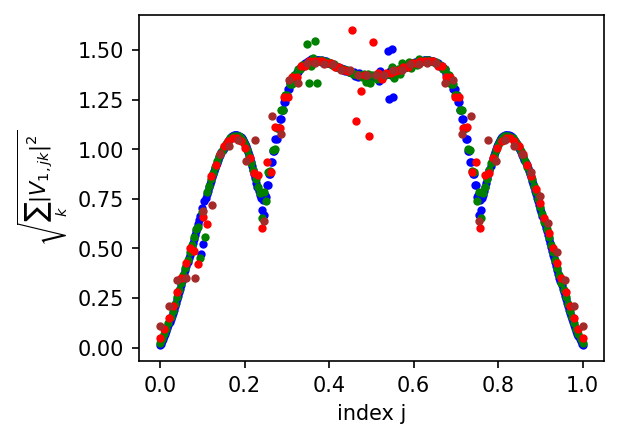

In [255]:
i_400 = np.linspace(0,1,400)
i_200 = np.linspace(0,1,200)
i_100 = np.linspace(0,1,100)
i_50  = np.linspace(0,1,50)
fig,ax = plt.subplots(1,1,figsize=(4,3),dpi=150)
ax.plot(i_400,np.sqrt(asum_400),'b.')
ax.plot(i_200,np.sqrt(asum_200),'g.')
ax.plot(i_100,np.sqrt(asum_100),'r.')
#ax.plot(i_100,np.sqrt(asum_100t),'c.')
#ax.plot(i_50,np.sqrt(asum_50t),'m.')
ax.plot(i_50 ,np.sqrt(asum_50) ,'.',color='brown')
ax.set_xlabel('index j')
ax.set_ylabel(r'$\sqrt{\sum_k |V_{1,jk}|^2}$')
plt.show()
# shape is independent of N

In [252]:
a = 1.0
eps = a; ex_bool = True
bsum_400 = make_pert_model(400,a,eps,ex_bool)
bsum_200 = make_pert_model(200,a,eps,ex_bool)
bsum_100 = make_pert_model(100,a,eps,ex_bool)
bsum_50  = make_pert_model(50 ,a,eps,ex_bool)

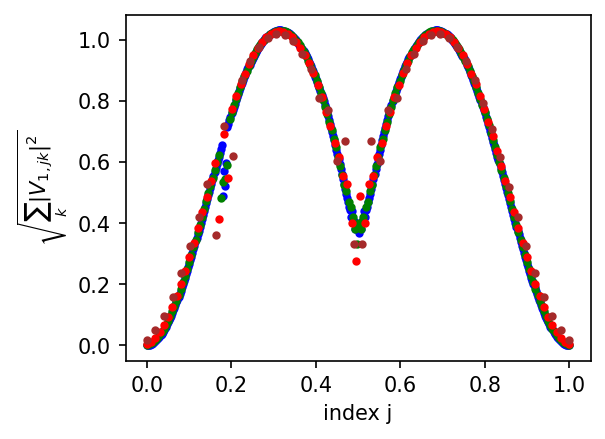

In [253]:
fig,ax = plt.subplots(1,1,figsize=(4,3),dpi=150)
ax.plot(i_400,np.sqrt(bsum_400),'b.')
ax.plot(i_200,np.sqrt(bsum_200),'g.')
ax.plot(i_100,np.sqrt(bsum_100),'r.')
ax.plot(i_50 ,np.sqrt(bsum_50),'.',color='brown')
ax.set_xlabel('index j')
ax.set_ylabel(r'$\sqrt{\sum_k |V_{1,jk}|^2}$')
plt.show()

/var/folders/l_/tk7gphlj0d38754sb6x8p1f00000gn/T/ipykernel_97504/4035637558.py:12: RuntimeWarning: divide by zero encountered in log
  im = axarr[1].imshow(np.log(pp2))


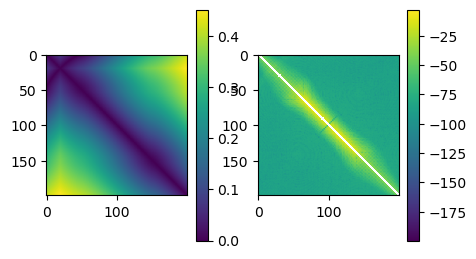

In [216]:
n = 200
a = 1.5
eps = 0.5
w, vr = eigs_h0(n,a,eps)
mat = mkfun(w) # my weird function
c_matrix,s_matrix, c2_matrix,s2_matrix,cs_matrix =  cs_matrix_elements(vr)
a_sum,pp2 = Vjksum(c_matrix,mat)  # we don't need to zero diagonal because mat is zero there

fig,axarr = plt.subplots(1,2,figsize=(5,3))
im = axarr[0].imshow(np.absolute(mat1))
plt.colorbar(im, ax = axarr[0])
im = axarr[1].imshow(np.log(pp2))
plt.colorbar(im, ax = axarr[1])
plt.show()


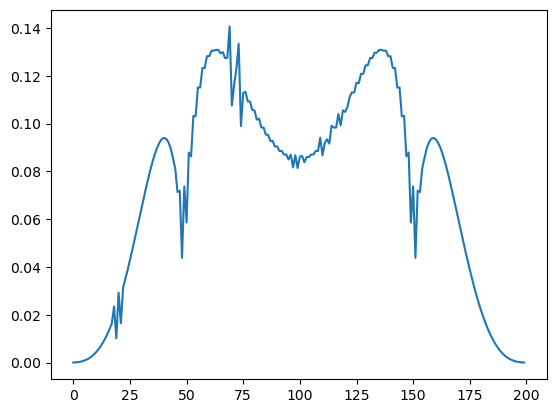

In [217]:
plt.plot(a_sum)
plt.show()

/var/folders/l_/tk7gphlj0d38754sb6x8p1f00000gn/T/ipykernel_97504/3509114820.py:12: RuntimeWarning: divide by zero encountered in log
  im = axarr[1].imshow(np.log(pp2))


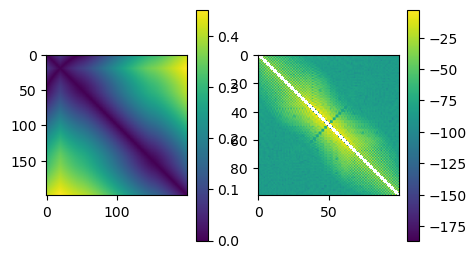

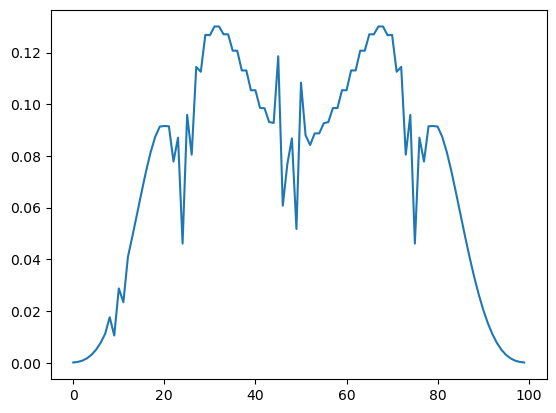

In [218]:
n = 100
a = 1.5
eps = 0.5
w, vr = eigs_h0(n,a,eps)
mat = mkfun(w)
c_matrix,s_matrix, c2_matrix,s2_matrix,cs_matrix =  cs_matrix_elements(vr)
a_sum,pp2 = Vjksum(c_matrix,mat)

fig,axarr = plt.subplots(1,2,figsize=(5,3))
im = axarr[0].imshow(np.absolute(mat1))
plt.colorbar(im, ax = axarr[0])
im = axarr[1].imshow(np.log(pp2))
plt.colorbar(im, ax = axarr[1])
plt.show()
plt.plot(a_sum)
plt.show()

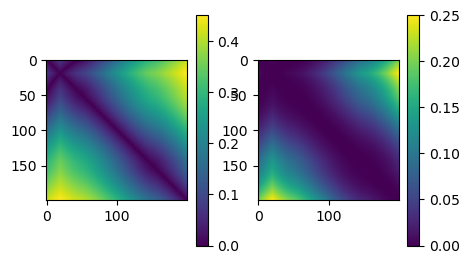

In [167]:
n = 200
a = 1.5
eps = 0.5
w, vr = eigs_h0(n,a,eps)
mat1,mat2,mat3 = ejk_mats(w)
fig,axarr = plt.subplots(1,2,figsize=(5,3))
im = axarr[0].imshow(np.absolute(mat1))
plt.colorbar(im, ax = axarr[0])
im2 = axarr[1].imshow(np.absolute(mat2))
plt.colorbar(im2, ax = axarr[1])
plt.show()

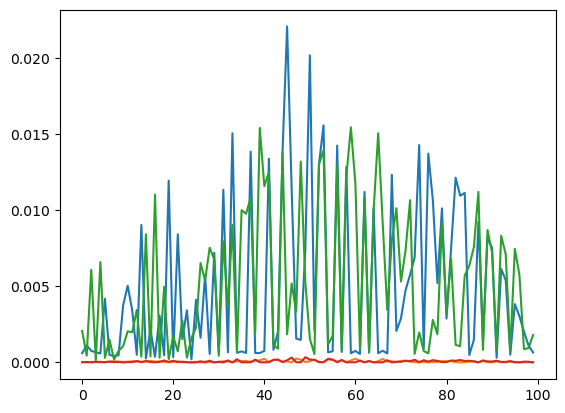

In [142]:
plt.plot(c1_sum)
plt.plot(c2_sum)
plt.plot(s1_sum)
plt.plot(s2_sum)
plt.show()

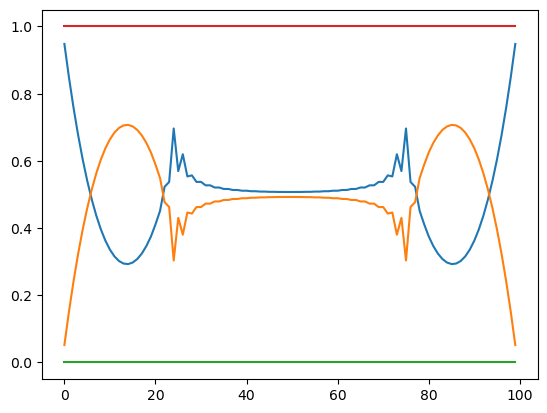

In [157]:
mat = np.identity(n)
c = Vjksum(c2_matrix,mat)
s = Vjksum(s2_matrix,mat)
cs = Vjksum(cs_matrix,mat)
plt.plot(c)
plt.plot(s)
plt.plot(cs)
plt.plot(s+c)
plt.show()

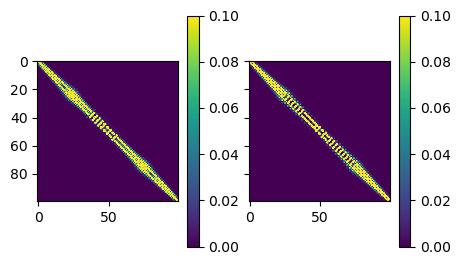

In [145]:
fig,axarr = plt.subplots(1,2,figsize=(5,3),sharex=True,sharey=True)
im0= axarr[0].imshow(np.absolute(c_matrix),vmax=0.1)
im1= axarr[1].imshow(np.absolute(s_matrix),vmax=0.1)
plt.colorbar(im0,ax=axarr[0])
plt.colorbar(im1,ax = axarr[1])
plt.show()

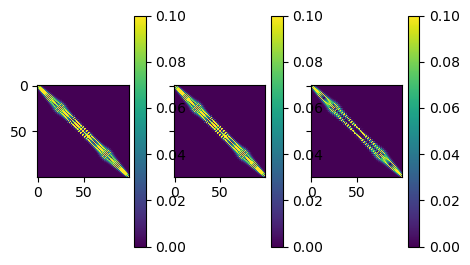

In [149]:
fig,axarr = plt.subplots(1,3,figsize=(5,3),sharex=True,sharey=True)
im0= axarr[0].imshow(np.absolute(c2_matrix),vmax=0.1)
im1= axarr[1].imshow(np.absolute(s2_matrix),vmax=0.1)
im2= axarr[2].imshow(np.absolute(cs_matrix),vmax=0.1)
plt.colorbar(im0,ax=axarr[0])
plt.colorbar(im1,ax = axarr[1])
plt.colorbar(im2,ax = axarr[2])
plt.show()

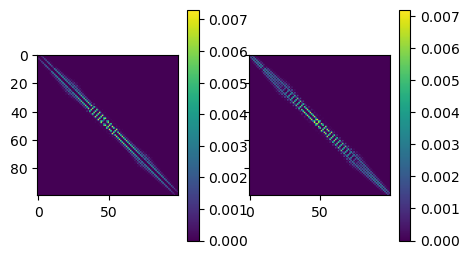

In [136]:
fig,axarr = plt.subplots(1,2,figsize=(5,3),sharex=True,sharey=True)
im0= axarr[0].imshow(np.absolute(c_matrix*mat1))
im1= axarr[1].imshow(np.absolute(s_matrix*mat1))
plt.colorbar(im0,ax=axarr[0])
plt.colorbar(im1,ax=axarr[1])
plt.show()

In [97]:
# compute < v_sep | cos phi | v_k> and <v_sep | sin phi v_k>
# for isep giving index of one of the eigenstates)
# arguments:
#  eigenvalues and eigenvectors of h0 and an index for the eigenvector 
def melement_cs(w,vr,isep):
    vj = np.squeeze(vr[:,isep])
    n = len(w)
    c_op = cos_phi_op(n)
    s_op = sin_phi_op(n)
    val_c = np.zeros(n,dtype = complex)
    val_s = np.zeros(n,dtype = complex)
    de_arr = np.zeros(n,dtype = float)  # diff in energy from ith's energy level
    zsum_c =0
    zsum_s =0
    for k in range(n):
        vk = np.squeeze(vr[:,k])
        zvec_c = np.matmul(c_op,vk)   # compute op|evec>
        zvec_s = np.matmul(s_op,vk)   # compute op|evec>
        val_c[k] =  np.vdot(vj,zvec_c)
        val_s[k] =  np.vdot(vj,zvec_s)
        de_arr[k] = np.real(w[k] - w[isep])
        
    for k in range(n):
        zsum_c += np.absolute(val_c[k])**2  
        zsum_s += np.absolute(val_s[k])**2  
        
    z_c  = np.sqrt(zsum_c)
    z_s  = np.sqrt(zsum_s)
    
    return val_c, val_s, z_c, z_s 



In [98]:
# create the hamiltonian and measure the shifts at the separatrix 
def comp_sum(n,a,eps):
   
    wsort,vrsort = eigs_h0(n,a,eps)
    isep1 = np.argmin(np.abs(wsort - eps))  # index of one separatrix 
    isep2 = np.argmin(np.abs(wsort - (2*a - eps))) # index of the other  separatrix 
    val_c1, val_s1, zc1,zs1 = melement_cs(wsort,vrsort,isep1)
    val_c2, val_s2, zc2,zs2 = melement_cs(wsort,vrsort,isep2)
    # computing the expectation values for cosins and sine shifts
    print(isep1,isep2)
    return val_c1, val_s1, zc1,zs1, val_c2, val_s2, zc2,zs2

n = 200
a = 1.5
eps = 0.5
val_c1, val_s1, zc1,zs1, val_c2, val_s2, zc2,zs2= comp_sum(n,a,eps)
print(zs1,zs1,zs2,zs2)

48 151
0.5437458489674711 0.5437458489674711 0.5437458489675883 0.5437458489675883


46 143
0.5308004319897766 0.5308004319897766 0.530800431989797 0.530800431989797
2 7
3 11
4 15
6 19
7 22
8 26
9 30
10 33
12 37
13 41
14 45
15 49
16 53
18 56
19 60
20 64
22 67
23 71
24 75
25 79
26 83
28 87
29 90
30 94
31 98
32 102
34 105
35 109
36 113
37 117
38 121
40 124
41 128
42 132
43 136
45 139
46 143
47 147


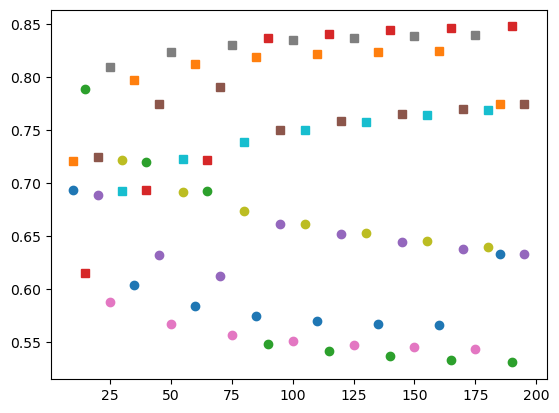

In [118]:
##### n = 200
a = 1.5
eps = 0.5
val_c1, val_s1, zc1,zs1, val_c2, val_s2, zc2,zs2= comp_sum(n,a,eps)
print(zs1,zs1,zs2,zs2)
for i in range(10,200,5):
    n = i
    val_c1, val_s1, zc1,zs1, val_c2, val_s2, zc2,zs2 = comp_sum(n,a,eps)
    #print(zs1,zs1,zs2,zs2)
    plt.plot([i],[zs1],'o')
    plt.plot([i],[zc1],'s')
    
plt.show()
# why is this decreasing with increasing N?

12 37
73 226


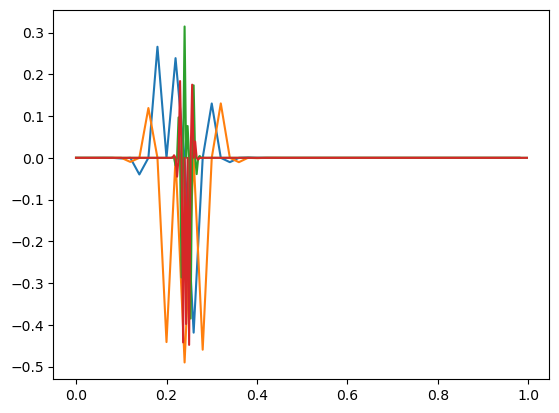

In [100]:
ilist = [50,300]

for n in ilist:
    val_c1, val_s1, zc1,zs1, val_c2, val_s2, zc2,zs2 = comp_sum(n,a,eps) 
    #print(zs1,zs1,zs2,zs2)
    #plt.plot([i],[zs1],'o')
    iarr = np.arange(n)/n
    #plt.plot(iarr,val_c1)
    plt.plot(iarr,val_s1)
    plt.plot(iarr,val_c1)
    
plt.show()


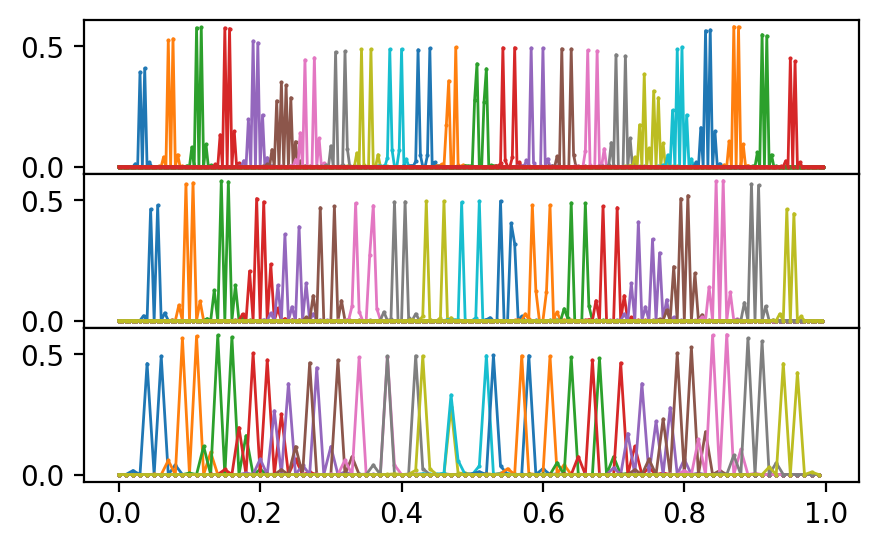

In [114]:

a = 1.5
eps = 0.5


fig,axarr = plt.subplots(3,1,figsize=(5,3),sharex=True,sharey=True,dpi=200)
plt.subplots_adjust(wspace=0,hspace=0)

n = 300
w, vr = eigs_h0(n,a,eps)
ilist = np.arange(10,291,12)
for isep in ilist:
    val_c, val_s, z_c, z_s  = melement_cs(w,vr,isep)
    iarr = np.arange(n)/n
    axarr[0].plot(iarr,np.abs(val_s),'.-',ms=1,lw=1)

n = 200
w, vr = eigs_h0(n,a,eps)
ilist = np.arange(10,191,10)
for isep in ilist:
    val_c, val_s, z_c, z_s  = melement_cs(w,vr,isep)
    iarr = np.arange(n)/n
    axarr[1].plot(iarr,np.abs(val_s),'.-',ms=1,lw=1)
    
n = 100
w, vr = eigs_h0(n,a,eps)

ilist = np.arange(5,96,5)
for isep in ilist:
    val_c, val_s, z_c, z_s  = melement_cs(w,vr,isep)
    iarr = np.arange(n)/n
    axarr[2].plot(iarr,np.abs(val_s),'.-',ms=1,lw=1)
    
plt.show()

    


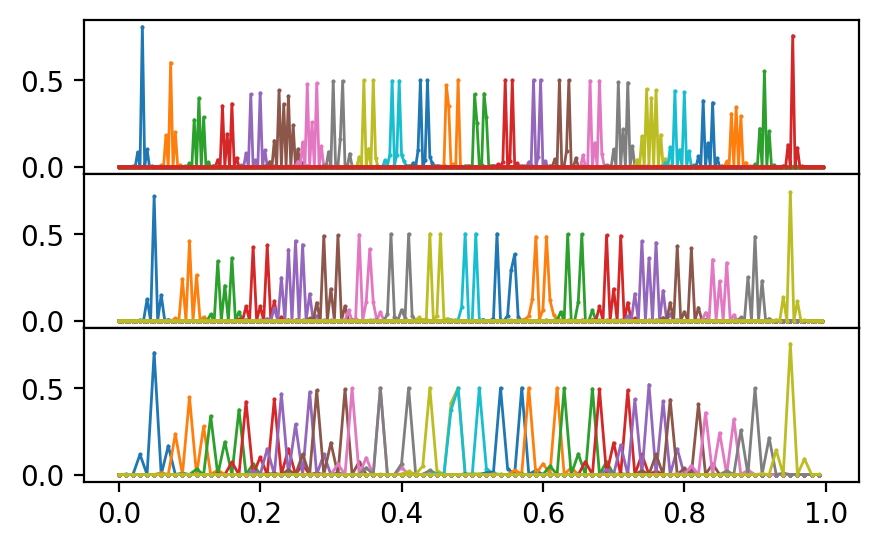

In [115]:
fig,axarr = plt.subplots(3,1,figsize=(5,3),sharex=True,sharey=True,dpi=200)
plt.subplots_adjust(wspace=0,hspace=0)


n = 300
w, vr = eigs_h0(n,a,eps)
ilist = np.arange(10,291,12)
for isep in ilist:
    val_c, val_s, z_c, z_s  = melement_cs(w,vr,isep)
    iarr = np.arange(n)/n
    axarr[0].plot(iarr,np.abs(val_c),'.-',ms=1,lw=1)

n = 200
w, vr = eigs_h0(n,a,eps)
ilist = np.arange(10,191,10)
for isep in ilist:
    val_c, val_s, z_c, z_s  = melement_cs(w,vr,isep)
    iarr = np.arange(n)/n
    axarr[1].plot(iarr,np.abs(val_c),'.-',ms=1,lw=1)
    
n = 100
w, vr = eigs_h0(n,a,eps)

ilist = np.arange(5,96,5)
for isep in ilist:
    val_c, val_s, z_c, z_s  = melement_cs(w,vr,isep)
    iarr = np.arange(n)/n
    axarr[2].plot(iarr,np.abs(val_c),'.-',ms=1,lw=1)
    
plt.show()

    


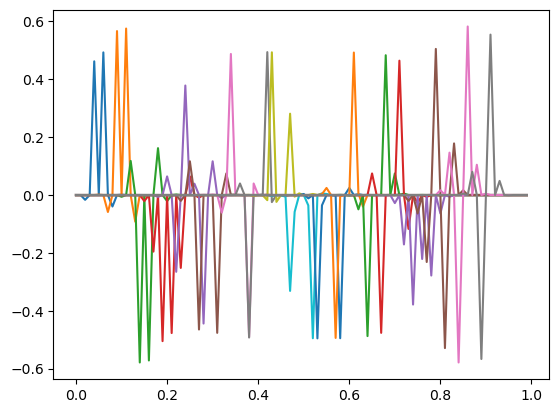

In [186]:
n = 200
a = 1.5
eps = 0.5
w, vr = eigs_h0(n,a,eps)
mu = 0.05; mup = mu; b = 0.0; taushift=0.0; ntau = 500

H0op = hat_h_0_new(n,a,eps) 
w,vr = eigs_h0(n,a,eps)  # eigenvals of h0 sorted 

w_s,vr_s,U_final  = U_prop2(n,ntau,a,b,eps,mu,mup,taushift) # create prop
wsort,vrsort,expsort,sigsort = esort_op(w_s,vr_s,H0op)  # sort eigenvecs of prop in order of <h0>
mat = state_prod(vr,vrsort)

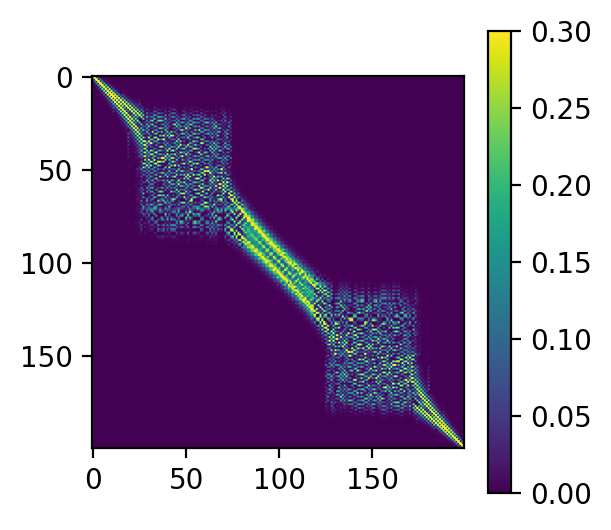

In [187]:
fig,ax = plt.subplots(1,1,figsize=(3,3),dpi=200)
im = ax.imshow(np.absolute(mat),vmax=0.3)
plt.colorbar(im)
plt.show()
# this definitely shows the chaotic region and illustrates that 
# somehow we need a theory that gives cross terms that are further away than what we have been doing 
# not perturbative !!!!!!!!

In [188]:
c_matrix,s_matrix, c2_matrix,s2_matrix,cs_matrix =  cs_matrix_elements(vr)

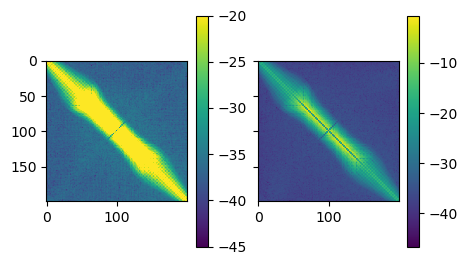

In [193]:
fig,axarr = plt.subplots(1,2,figsize=(5,3),sharex=True,sharey=True)
im0= axarr[0].imshow(np.log(np.absolute(c_matrix)),vmin=-45,vmax=-20)
im1= axarr[1].imshow(np.log(np.absolute(s_matrix)))
plt.colorbar(im0,ax=axarr[0])
plt.colorbar(im1,ax = axarr[1])
plt.show()

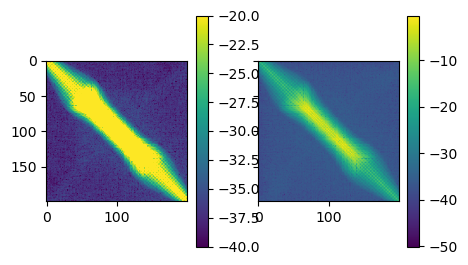

In [192]:
fig,axarr = plt.subplots(1,2,figsize=(5,3),sharex=True,sharey=True)
im0= axarr[0].imshow(np.log(np.absolute(c2_matrix)),vmin=-40,vmax=-20)
im1= axarr[1].imshow(np.log(np.absolute(s2_matrix)))
plt.colorbar(im0,ax=axarr[0])
plt.colorbar(im1,ax = axarr[1])
plt.show()